# Принцип работы

- обученная на распознавании маркировки Yolo11 выделяет bbox маркировку детали;

- кропы подаются на PaddleOCR, которая способна понимать изображения в перспективе и повёрнутые;

- распознанный текст векторизируется эмбеддером BAAI/bge-m3, и сравнивается с эмбеддингами в векторной БД на Faiss

- находим вектор с наименьшим косинусным расстоянием;

- выбираем top_k кандидатов = 10, что бы в дальнейшем добавить ещё модель ранжировани;

# Requirements

In [1]:
"""
faiss_cpu==1.7.4
faiss_gpu==1.7.2
numpy==1.23.5
opencv_contrib_python==4.10.0.84
opencv_python==4.7.0.72
opencv_python_headless==4.10.0.84
paddleocr==2.9.1
paddleocr.egg==info
pandas==2.0.2
Pillow==11.0.0
torch==2.5.1+cu124
transformers==4.45.1
ultralytics==8.3.28
"""

'\nfaiss_cpu==1.7.4\nfaiss_gpu==1.7.2\nnumpy==1.23.5\nopencv_contrib_python==4.10.0.84\nopencv_python==4.7.0.72\nopencv_python_headless==4.10.0.84\npaddleocr==2.9.1\npaddleocr.egg==info\npandas==2.0.2\nPillow==11.0.0\ntorch==2.5.1+cu124\ntransformers==4.45.1\nultralytics==8.3.28\n'

In [2]:
# !pip install -r requirements.txt

# Импорт

In [3]:
import os
from pathlib import Path
import re
import time
from PIL import Image, ImageDraw
import cv2
import csv
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import ultralytics
from ultralytics import YOLO
ultralytics.checks()

import easyocr
from paddleocr import PaddleOCR, draw_ocr

import torch
print(torch.__version__)
from torch import Tensor
from transformers import AutoModel, AutoTokenizer

import faiss

Ultralytics 8.3.28 🚀 Python-3.10.12 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 4090, 24108MiB)
Setup complete ✅ (32 CPUs, 125.6 GB RAM, 3328.7/3666.0 GB disk)
2.5.1+cu124


# Настройки

Специфика заказчика - работа без выхода в интернет, поэтому работаем с локальными моделями.

In [4]:
config = {
    'yolo_weights': 'weights/best.pt',
    'bge3m_path': '/home/best/Code/MODELS/bge-m3',  # локальная модель
    'test_tmages_dir': 'datasets/test/imgs',
    'text_files_dir': 'datasets/train/text',  # Содержит текст маркировки, нужен для формированиф БД
}

# Классы, модели

## Embedder

In [5]:
class ModelBgeM3:
    def __init__(self, config):
        model_name = config['bge3m_path']
        self.tokenizer = AutoTokenizer.from_pretrained(model_name, local_files_only=True)
        self.model = AutoModel.from_pretrained(model_name)


    def encode(self, input_texts):
        batch_dict = self.tokenizer(input_texts, max_length=512, padding=True, truncation=True, return_tensors='pt')
        outputs = self.model(**batch_dict)
        embeddings = self.average_pool(outputs.last_hidden_state, batch_dict['attention_mask'])
        return embeddings.detach().numpy()

    
    def average_pool(self, last_hidden_states: Tensor, attention_mask: Tensor) -> Tensor:
        last_hidden = last_hidden_states.masked_fill(~attention_mask[..., None].bool(), 0.0)
        return last_hidden.sum(dim=1) / attention_mask.sum(dim=1)[..., None]

## Векторная БД

Хранит векторное представление маркировки

In [6]:
class Faiss:
    def __init__(self, model_emb):
        self.model_emb = model_emb
        self.df = None
        self.faiss_db = faiss.IndexFlatL2(1024)


    def createDb(self, path):
        text_list = []
        for filename in sorted(os.listdir(path)):
            name = filename.split('.')[0]
            text_path = path + '/' + filename
            with open(text_path, 'r', encoding='utf-8') as file:
                text = file.readline().replace('"', '').replace('\n', '')
                text_list.append([name, text])
                emb = self.model_emb.encode(text)
                self.faiss_db.add(emb)

        self.df = pd.DataFrame(text_list, columns=['Name', 'Text'])


    def search(self, emb):
        return self.faiss_db.search(emb, 10)

In [7]:
model_emb = ModelBgeM3(config)

### Создаём векторную БД
Хранилище эмбеддингов маркировки + датафрейм данных

In [8]:
model_faiss = Faiss(model_emb)
model_faiss.createDb(config['text_files_dir'])

# Количество векторов
model_faiss.faiss_db.ntotal

254

In [9]:
# Посмотрим датафрем
model_faiss.df

,Name,Text
0,1,АНЕМ.492664.500-03LP 497/2
1,102,АМ117.07.01.211 29
2,105,АМ117.07.01.210 31
3,107,АМ117.07.01.210 31
4,109,АМ117.07.01.210 32
...,...,...
249,86,195-30-1221 3583-3594
250,92,1391-30-1151
251,94,АМ117.07.01.211 25
252,96,АМ117.07.01.211 26


## Yolo

In [10]:
# YOLO 11
model_yolo = YOLO(config['yolo_weights'])

## OCR

In [11]:
ocr = PaddleOCR(use_angle_cls=True, lang='en', use_gpu=True)

[2024/11/10 10:52:19] ppocr DEBUG: Namespace(help='==SUPPRESS==', use_gpu=False, use_xpu=False, use_npu=False, use_mlu=False, ir_optim=True, use_tensorrt=False, min_subgraph_size=15, precision='fp32', gpu_mem=500, gpu_id=0, image_dir=None, page_num=0, det_algorithm='DB', det_model_dir='/home/best/.paddleocr/whl/det/en/en_PP-OCRv3_det_infer', det_limit_side_len=960, det_limit_type='max', det_box_type='quad', det_db_thresh=0.3, det_db_box_thresh=0.6, det_db_unclip_ratio=1.5, max_batch_size=10, use_dilation=False, det_db_score_mode='fast', det_east_score_thresh=0.8, det_east_cover_thresh=0.1, det_east_nms_thresh=0.2, det_sast_score_thresh=0.5, det_sast_nms_thresh=0.2, det_pse_thresh=0, det_pse_box_thresh=0.85, det_pse_min_area=16, det_pse_scale=1, scales=[8, 16, 32], alpha=1.0, beta=1.0, fourier_degree=5, rec_algorithm='SVTR_LCNet', rec_model_dir='/home/best/.paddleocr/whl/rec/en/en_PP-OCRv4_rec_infer', rec_image_inverse=True, rec_image_shape='3, 48, 320', rec_batch_num=6, max_text_length

# Predict - основная функция

In [38]:
def predict_images(model_yolo, ocr, input_folder):
    result_list = []
    
    for file_name in os.listdir(input_folder):
        if not file_name.lower().endswith(('.png', '.jpg', '.jpeg')):
            continue
        time_start = time.time()
        file_path = input_folder + '/' + file_name
        # print(file_path)
        img = Image.open(file_path)
        print('IMAGE SIZE;', img.size)
        predict = model_yolo(img)
        for p in predict:     
            im_np = p.plot()
            im_orig = p.orig_img
            # print('IM ORIG, SHAPE', im_orig.shape)

            bbox = p.boxes.xyxyn.data.detach().cpu().numpy()
            bbox_whn = p.boxes.xywhn.data.detach().cpu().numpy()
            # print('BBOX', bbox)
            print('BBOX WH', bbox_whn)
            if len(bbox_whn) == 0:
                label = '0 0.5 0.5 0.8 0.8'
                crop = p.orig_img
            else:     
                label = f'0 {bbox_whn[0][0]} {bbox_whn[0][1]} {bbox_whn[0][2]} {bbox_whn[0][3]}'
                # Внимание! Изображежие x, y, 3, arr => y, x, 3
                x1 = round(im_orig.shape[1]*bbox[0][0])
                y1 = round(im_orig.shape[0]*bbox[0][1])
                x2 = round(im_orig.shape[1]*bbox[0][2])
                y2 = round(im_orig.shape[0]*bbox[0][3])
                print('COORD', x1, x2, y1, y2)
                crop = p.orig_img[y1:y2,x1:x2,:]
            
            print('CROP', crop.shape)
            
            # cropped_img_rgb = cv2.cvtColor(crop, cv2.COLOR_BGR2RGB)
            
            im_crop = Image.fromarray(crop)  # RGB PIL image

            plt.imshow(im_crop, interpolation='nearest')
            plt.show()
            
            im_crop.save('crop.png')
             
            # OCR
            img_crop = 'crop.png'
            result = ocr.ocr(img_crop, cls=True)
            print('RESULT', result)
            if result[0] is None:
                result_list.append([file_name, label, ''])
                continue
            
            recognized_text = []
            for line in result:
              for word_info in line:
                text = word_info[1][0]  # Извлечение текста
                recognized_text.append(text)
            extracted_text = ' '.join(recognized_text)
            emb = model_emb.encode(extracted_text)
            # print("Распознанный текст:", extracted_text)
            D, I = model_faiss.search(emb)
            
            print(D[0])
            print(I[0][0])
            idx = I[0][0]
            row = model_faiss.df.iloc[idx]
            # print("ROW", row)
            
            marking = f'"{row[1]}"'
            
            print("РАСПОЗНАННЫЙ ТЕКСТ:", extracted_text)
            print("МАРКИРОВКА:", marking)
            
            result_list.append([file_name, label, marking])
            
            delta_time = time.time() - time_start
            print(delta_time)
        print("==========================================\n")
    return result_list

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.9ms
Speed: 12.8ms preprocess, 6.9ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[     0.4989     0.25895     0.71963     0.19861]]
COORD 134 824 204 459
CROP (255, 690, 3)


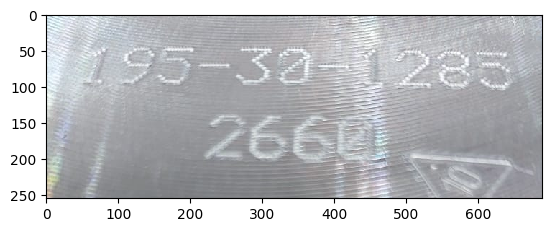

[2024/11/10 11:18:38] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.0440521240234375
[2024/11/10 11:18:38] ppocr DEBUG: cls num  : 2, elapsed : 0.0031113624572753906
[2024/11/10 11:18:38] ppocr DEBUG: rec_res num  : 2, elapsed : 0.05736589431762695
RESULT [[[[[54.0, 37.0], [645.0, 44.0], [644.0, 105.0], [54.0, 97.0]], ('195-30-1283', 0.9493805170059204)], [[[223.0, 137.0], [466.0, 141.0], [465.0, 203.0], [222.0, 200.0]], ('2660', 0.9632192850112915)]]]
[     26.216      49.095      49.095      49.095      60.799      60.799      60.799      67.567      67.567       67.95]
24
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1283 2660
МАРКИРОВКА: "195-30-1285 2660"
0.3358311653137207

IMAGE SIZE; (1280, 960)

0: 480x640 1 marking, 6.0ms
Speed: 0.9ms preprocess, 6.0ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.55798      0.5233       0.299     0.59186]]
COORD 523 906 218 786
CROP (568, 383, 3)


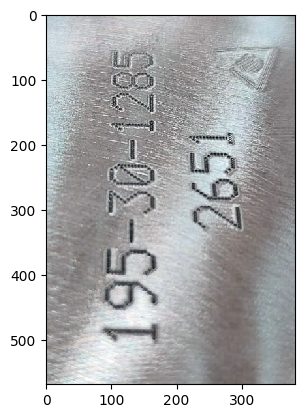

[2024/11/10 11:18:39] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.03677964210510254
[2024/11/10 11:18:39] ppocr DEBUG: cls num  : 2, elapsed : 0.003359556198120117
[2024/11/10 11:18:39] ppocr DEBUG: rec_res num  : 2, elapsed : 0.04825234413146973
RESULT [[[[[73.0, 43.0], [185.0, 43.0], [185.0, 516.0], [73.0, 516.0]], ('195-30-1285', 0.976218581199646)], [[[205.0, 170.0], [305.0, 166.0], [312.0, 339.0], [212.0, 343.0]], ('2651', 0.9991711378097534)]]]
[          0      31.927      32.193      32.193      32.193      35.256      35.347       38.23       38.23      41.281]
81
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1285 2651
МАРКИРОВКА: "195-30-1285 2651"
0.3138740062713623

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.5ms
Speed: 0.8ms preprocess, 6.5ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.51061     0.44004     0.36263     0.21337]]
COORD 316 664 427 700
CROP (273, 348, 3)


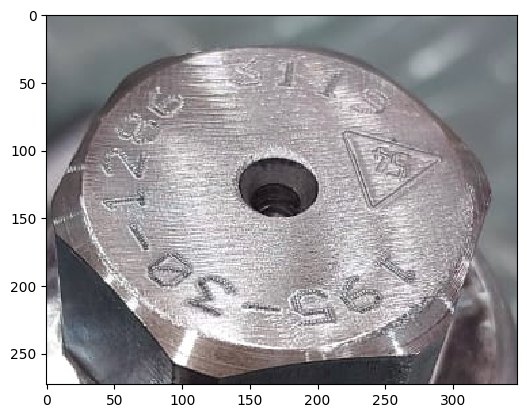

[2024/11/10 11:18:39] ppocr DEBUG: dt_boxes num : 3, elapsed : 0.036173343658447266
[2024/11/10 11:18:39] ppocr DEBUG: cls num  : 3, elapsed : 0.005136251449584961
[2024/11/10 11:18:39] ppocr DEBUG: rec_res num  : 3, elapsed : 0.06390762329101562
RESULT [None]

IMAGE SIZE; (1280, 960)

0: 480x640 2 markings, 6.0ms
Speed: 0.9ms preprocess, 6.0ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.42545     0.45723     0.34314     0.65452]
 [    0.95356     0.61862    0.092879     0.58224]]
COORD 325 764 125 753
CROP (628, 439, 3)


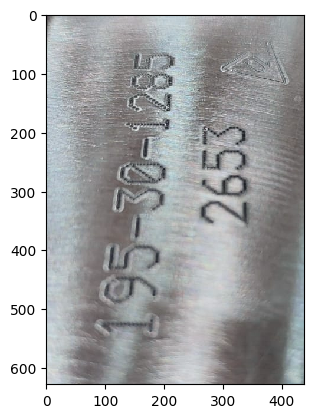

[2024/11/10 11:18:39] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.06061387062072754
[2024/11/10 11:18:39] ppocr DEBUG: cls num  : 2, elapsed : 0.0034835338592529297
[2024/11/10 11:18:39] ppocr DEBUG: rec_res num  : 2, elapsed : 0.039122581481933594
RESULT [[[[[109.0, 33.0], [255.0, 46.0], [212.0, 526.0], [67.0, 513.0]], ('95-30-1285', 0.939706027507782)], [[[250.0, 176.0], [354.0, 174.0], [357.0, 365.0], [253.0, 366.0]], ('2653', 0.9982667565345764)]]]
[      53.01       53.01      77.975      77.975      82.331      82.331      82.331      85.316      85.316      85.416]
85
РАСПОЗНАННЫЙ ТЕКСТ: 95-30-1285 2653
МАРКИРОВКА: "195-30-1285 2653"
0.34591150283813477

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.8ms
Speed: 0.9ms preprocess, 6.8ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.47123     0.38724     0.63248      0.2401]]
COORD 149 756 342 649
CROP (307, 607, 3)


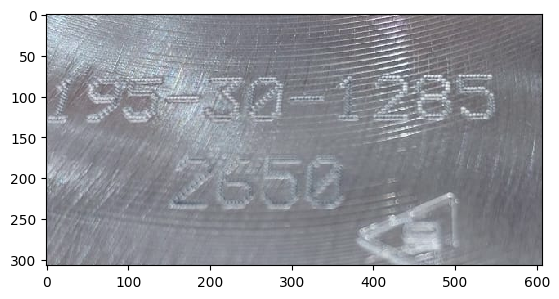

[2024/11/10 11:18:39] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.05281853675842285
[2024/11/10 11:18:39] ppocr DEBUG: cls num  : 2, elapsed : 0.0032334327697753906
[2024/11/10 11:18:40] ppocr DEBUG: rec_res num  : 2, elapsed : 0.056458473205566406
RESULT [[[[[20.0, 67.0], [550.0, 69.0], [550.0, 135.0], [20.0, 133.0]], ('95-30-1285', 0.8378076553344727)], [[[154.0, 161.0], [371.0, 164.0], [369.0, 245.0], [152.0, 241.0]], ('$650', 0.7151281237602234)]]]
[      175.5       175.5      184.47      184.49      189.22      189.22      191.15      191.15      191.15      195.82]
78
РАСПОЗНАННЫЙ ТЕКСТ: 95-30-1285 $650
МАРКИРОВКА: "195-30-1285 2650"
0.33506178855895996

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 0.9ms preprocess, 6.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.53346     0.48704     0.68239     0.22378]]
COORD 185 840 480 767
CROP (287, 655, 3)


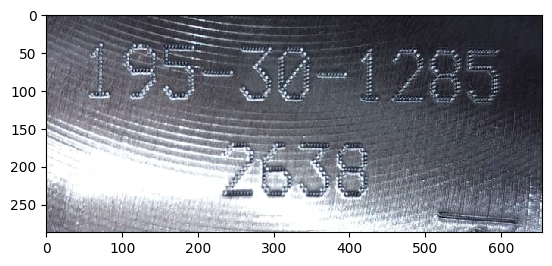

[2024/11/10 11:18:40] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.05305600166320801
[2024/11/10 11:18:40] ppocr DEBUG: cls num  : 2, elapsed : 0.003108978271484375
[2024/11/10 11:18:40] ppocr DEBUG: rec_res num  : 2, elapsed : 0.0550076961517334
RESULT [[[[[58.0, 38.0], [597.0, 45.0], [596.0, 117.0], [57.0, 109.0]], ('195-30-1285', 0.9568031430244446)], [[[229.0, 157.0], [433.0, 162.0], [430.0, 251.0], [226.0, 246.0]], ('2639', 0.8678902387619019)]]]
[          0           0      35.534      35.534      36.728      36.728      39.291      53.814      55.281      55.281]
57
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1285 2639
МАРКИРОВКА: "195-30-1285 2639"
0.3315773010253906

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 0.9ms preprocess, 6.3ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[     0.4756     0.45308     0.50365     0.35088]]
COORD 215 698 355 804
CROP (449, 483, 3)


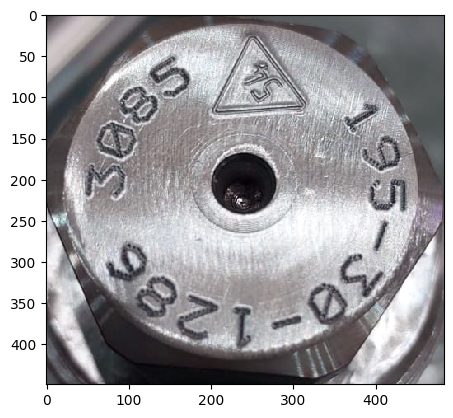

[2024/11/10 11:18:40] ppocr DEBUG: dt_boxes num : 4, elapsed : 0.05164909362792969
[2024/11/10 11:18:40] ppocr DEBUG: cls num  : 4, elapsed : 0.011051654815673828
[2024/11/10 11:18:40] ppocr DEBUG: rec_res num  : 4, elapsed : 0.07940292358398438
RESULT [[[[[53.0, 296.0], [103.0, 252.0], [189.0, 349.0], [139.0, 393.0]], ('98', 0.9895565509796143)], [[[297.0, 348.0], [383.0, 273.0], [422.0, 317.0], [337.0, 392.0]], ('30', 0.8463889956474304)]]]
[     261.92      261.92      261.92      264.71      266.38      266.38      269.43      284.28      284.28       284.3]
33
РАСПОЗНАННЫЙ ТЕКСТ: 98 30
МАРКИРОВКА: "195-30-1286 3093"
0.3633759021759033

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.5ms
Speed: 0.9ms preprocess, 6.5ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.46903     0.43322     0.32141     0.22081]]
COORD 296 605 413 696
CROP (283, 309, 3)


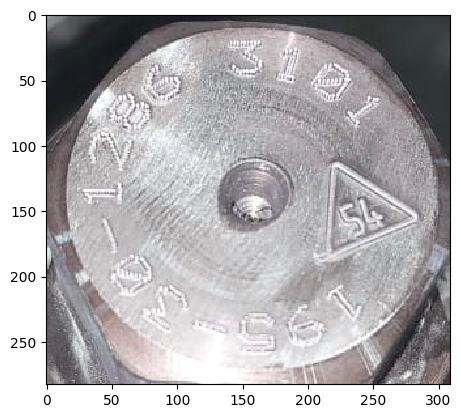

[2024/11/10 11:18:40] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.03303861618041992
[2024/11/10 11:18:40] ppocr DEBUG: cls num  : 2, elapsed : 0.003130197525024414
[2024/11/10 11:18:41] ppocr DEBUG: rec_res num  : 2, elapsed : 0.03875875473022461
RESULT [None]

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 0.9ms preprocess, 6.3ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.42521     0.26486     0.66054     0.19145]]
COORD 91 725 216 462
CROP (246, 634, 3)


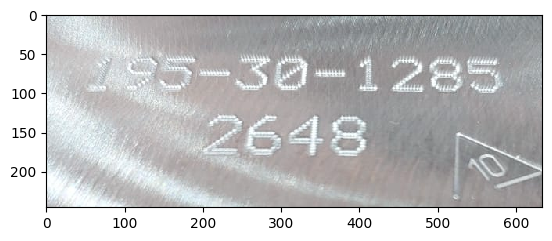

[2024/11/10 11:18:41] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.04956960678100586
[2024/11/10 11:18:41] ppocr DEBUG: cls num  : 2, elapsed : 0.0031719207763671875
[2024/11/10 11:18:41] ppocr DEBUG: rec_res num  : 2, elapsed : 0.07401704788208008
RESULT [[[[[52.0, 50.0], [578.0, 54.0], [577.0, 100.0], [51.0, 96.0]], ('0550128', 0.5710280537605286)], [[[202.0, 125.0], [413.0, 125.0], [413.0, 183.0], [202.0, 183.0]], ('2648', 0.9959630370140076)]]]
[     190.56      217.17      217.17      228.84      228.84      228.84      230.77      230.77      231.93      231.93]
75
РАСПОЗНАННЫЙ ТЕКСТ: 0550128 2648
МАРКИРОВКА: "195-30-1285 2648"
0.33371806144714355

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 0.9ms preprocess, 6.3ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.44474     0.45023     0.19242     0.29226]]
COORD 335 519 389 763
CROP (374, 184, 3)


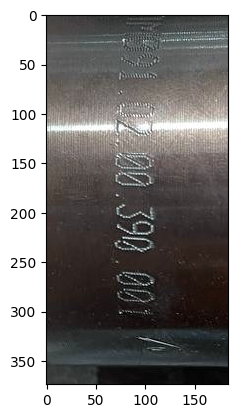

[2024/11/10 11:18:41] ppocr DEBUG: dt_boxes num : 3, elapsed : 0.028384685516357422
[2024/11/10 11:18:41] ppocr DEBUG: cls num  : 3, elapsed : 0.009997129440307617
[2024/11/10 11:18:41] ppocr DEBUG: rec_res num  : 3, elapsed : 0.06600308418273926
RESULT [[[[[68.0, 139.0], [112.0, 139.0], [112.0, 299.0], [68.0, 299.0]], ('00.390.00', 0.981627881526947)]]]
[      364.6      370.31      370.31      370.31      370.31      370.31      376.33      397.75      397.75      397.75]
234
РАСПОЗНАННЫЙ ТЕКСТ: 00.390.00
МАРКИРОВКА: "1391-30-0109 243"
0.2781815528869629

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 0.8ms preprocess, 6.3ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[     0.4266     0.50202     0.50796     0.15521]]
COORD 166 653 543 742
CROP (199, 487, 3)


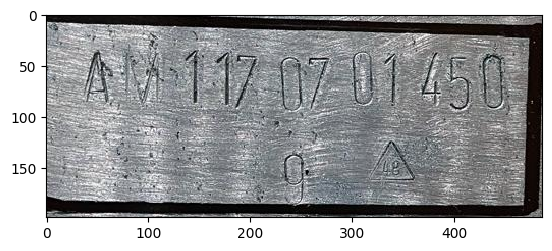

[2024/11/10 11:18:41] ppocr DEBUG: dt_boxes num : 1, elapsed : 0.03679013252258301
[2024/11/10 11:18:41] ppocr DEBUG: cls num  : 1, elapsed : 0.00904703140258789
[2024/11/10 11:18:41] ppocr DEBUG: rec_res num  : 1, elapsed : 0.027463436126708984
RESULT [[[[[38.0, 31.0], [454.0, 40.0], [453.0, 94.0], [37.0, 85.0]], ('A117-07-01450', 0.9117430448532104)]]]
[     278.13      295.58      295.58      297.27      297.27      303.31      303.31      303.31      309.55      309.55]
18
РАСПОЗНАННЫЙ ТЕКСТ: A117-07-01450
МАРКИРОВКА: "АМ117.07.01.300 11"
0.2765164375305176

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.5ms
Speed: 0.9ms preprocess, 6.5ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.47096     0.46511     0.44881     0.32834]]
COORD 237 668 385 805
CROP (420, 431, 3)


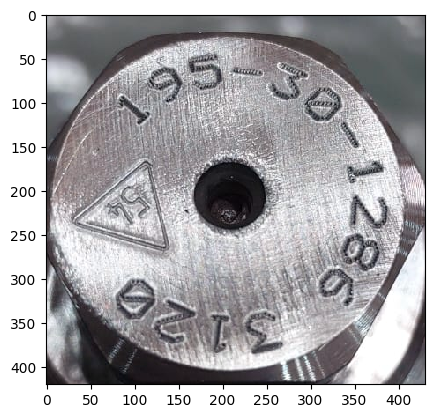

[2024/11/10 11:18:42] ppocr DEBUG: dt_boxes num : 6, elapsed : 0.04734468460083008
[2024/11/10 11:18:42] ppocr DEBUG: cls num  : 6, elapsed : 0.012038946151733398
[2024/11/10 11:18:42] ppocr DEBUG: rec_res num  : 6, elapsed : 0.11376094818115234
RESULT [[[[[149.0, 42.0], [201.0, 42.0], [201.0, 94.0], [149.0, 94.0]], ('5', 0.9857056140899658)], [[[61.0, 100.0], [141.0, 38.0], [179.0, 85.0], [99.0, 147.0]], ('19', 0.9958579540252686)], [[[87.0, 278.0], [190.0, 329.0], [160.0, 387.0], [57.0, 337.0]], ('20', 0.9931159019470215)], [[[181.0, 336.0], [216.0, 336.0], [216.0, 381.0], [181.0, 381.0]], ('I', 0.5611720085144043)], [[[219.0, 336.0], [264.0, 336.0], [264.0, 384.0], [219.0, 384.0]], ('S', 0.7204031944274902)]]]
[     385.14      385.14      385.14      408.96      408.96      433.93      433.93      434.41      434.51      434.51]
155
РАСПОЗНАННЫЙ ТЕКСТ: 5 19 20 I S
МАРКИРОВКА: "АМ116.05.02.201 5"
0.4075741767883301

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.7ms
Speed: 0.9ms p

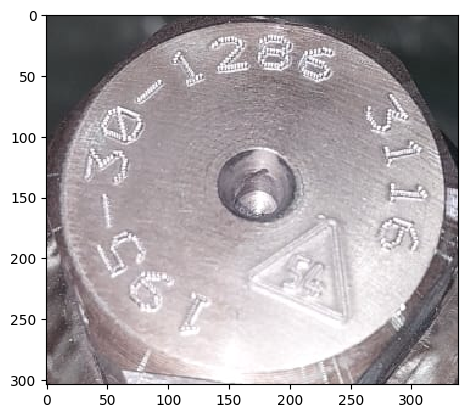

[2024/11/10 11:18:42] ppocr DEBUG: dt_boxes num : 7, elapsed : 0.038014888763427734
[2024/11/10 11:18:42] ppocr DEBUG: cls num  : 7, elapsed : 0.009756803512573242
[2024/11/10 11:18:42] ppocr DEBUG: rec_res num  : 7, elapsed : 0.13432931900024414
RESULT [[[[[51.0, 65.0], [88.0, 75.0], [67.0, 148.0], [30.0, 138.0]], ('05', 0.5020658373832703)]]]
[     368.99      368.99      368.99      373.24      373.24      455.07      455.07      455.07      481.11      484.74]
155
РАСПОЗНАННЫЙ ТЕКСТ: 05
МАРКИРОВКА: "АМ116.05.02.201 5"
0.3695194721221924

IMAGE SIZE; (1280, 960)

0: 480x640 1 marking, 6.0ms
Speed: 0.8ms preprocess, 6.0ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.55603     0.62422       0.591     0.55856]]
COORD 333 1090 331 867
CROP (536, 757, 3)


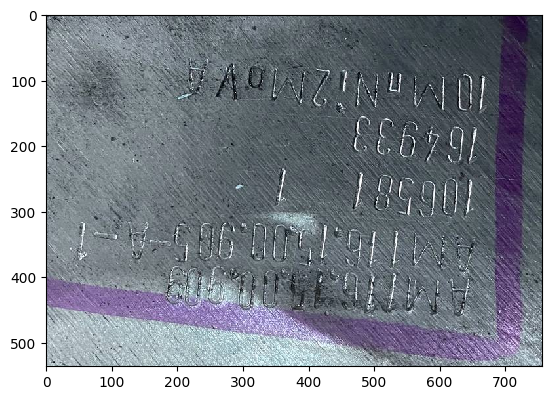

[2024/11/10 11:18:42] ppocr DEBUG: dt_boxes num : 5, elapsed : 0.07242488861083984
[2024/11/10 11:18:42] ppocr DEBUG: cls num  : 5, elapsed : 0.011557340621948242
[2024/11/10 11:18:43] ppocr DEBUG: rec_res num  : 5, elapsed : 0.1276075839996338
RESULT [[[[[466.0, 149.0], [664.0, 170.0], [657.0, 234.0], [459.0, 213.0]], ('66791', 0.7602777481079102)], [[[461.0, 233.0], [660.0, 244.0], [656.0, 315.0], [457.0, 304.0]], ('106581', 0.8945028185844421)], [[[51.0, 302.0], [658.0, 328.0], [655.0, 395.0], [48.0, 369.0]], ('-1-50600510//29', 0.5299111604690552)]]]
[     270.94      272.22      272.22      272.22      278.59      278.59      278.59      278.59      280.48      283.06]
249
РАСПОЗНАННЫЙ ТЕКСТ: 66791 106581 -1-50600510//29
МАРКИРОВКА: "195-30-1221 3583-3594"
0.5194127559661865

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.5ms
Speed: 0.9ms preprocess, 6.5ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.46455     0.50681     0.64048     0.24124]]

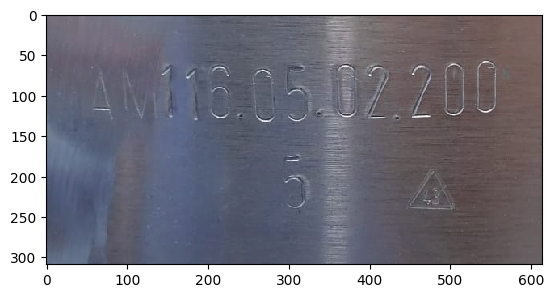

[2024/11/10 11:18:43] ppocr DEBUG: dt_boxes num : 1, elapsed : 0.05238747596740723
[2024/11/10 11:18:43] ppocr DEBUG: cls num  : 1, elapsed : 0.004264354705810547
[2024/11/10 11:18:43] ppocr DEBUG: rec_res num  : 1, elapsed : 0.03450727462768555
RESULT [[[[[62.0, 65.0], [556.0, 59.0], [557.0, 125.0], [63.0, 132.0]], ('AM116.05.02.200', 0.9044269323348999)]]]
[     75.808       86.39       86.39       86.39       128.3       128.3      158.91      158.91      158.91      158.91]
140
РАСПОЗНАННЫЙ ТЕКСТ: AM116.05.02.200
МАРКИРОВКА: "АМ116.05.02.200 2"
0.3030853271484375

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 0.9ms preprocess, 6.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.42538     0.40842     0.30485     0.38962]]
COORD 262 555 273 772
CROP (499, 293, 3)


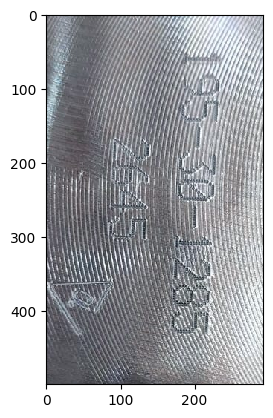

[2024/11/10 11:18:43] ppocr DEBUG: dt_boxes num : 1, elapsed : 0.04005742073059082
[2024/11/10 11:18:43] ppocr DEBUG: cls num  : 1, elapsed : 0.004208803176879883
[2024/11/10 11:18:43] ppocr DEBUG: rec_res num  : 1, elapsed : 0.022635936737060547
RESULT [[[[[174.0, 102.0], [237.0, 104.0], [224.0, 432.0], [161.0, 430.0]], ('15-30-1285', 0.7429564595222473)]]]
[     194.02      194.02      219.45      223.48      236.47      237.86      240.77      240.77      241.91      247.47]
26
РАСПОЗНАННЫЙ ТЕКСТ: 15-30-1285
МАРКИРОВКА: "195-30-1286 3085"
0.25949740409851074

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.5ms
Speed: 0.9ms preprocess, 6.5ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.44528     0.44642     0.52101     0.35951]]
COORD 177 678 341 802
CROP (461, 501, 3)


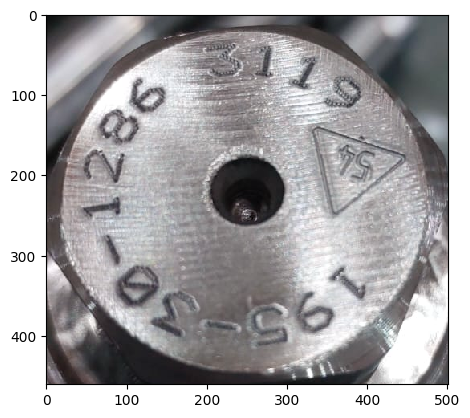

[2024/11/10 11:18:43] ppocr DEBUG: dt_boxes num : 6, elapsed : 0.05405712127685547
[2024/11/10 11:18:43] ppocr DEBUG: cls num  : 6, elapsed : 0.011947154998779297
[2024/11/10 11:18:44] ppocr DEBUG: rec_res num  : 6, elapsed : 0.11310315132141113
RESULT [[[[[306.0, 342.0], [364.0, 342.0], [364.0, 398.0], [306.0, 398.0]], ('6', 0.7954800128936768)]]]
[     351.16      351.16      351.16      351.16      353.04      353.04      460.75      460.75      460.75      460.75]
158
РАСПОЗНАННЫЙ ТЕКСТ: 6
МАРКИРОВКА: "АМ116.05.02.201 6"
0.3949604034423828

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.7ms
Speed: 0.9ms preprocess, 6.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.60618     0.49204     0.66217     0.35903]]
COORD 264 900 400 860
CROP (460, 636, 3)


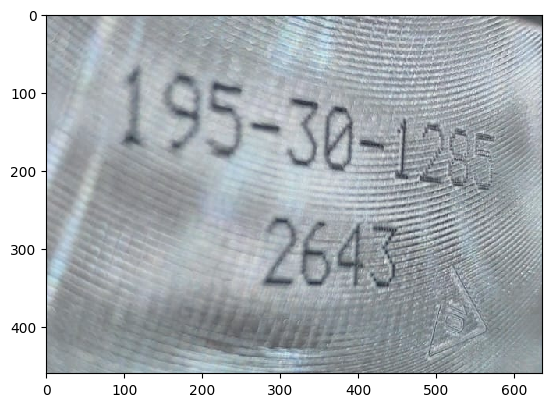

[2024/11/10 11:18:44] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.054177045822143555
[2024/11/10 11:18:44] ppocr DEBUG: cls num  : 2, elapsed : 0.0043926239013671875
[2024/11/10 11:18:44] ppocr DEBUG: rec_res num  : 2, elapsed : 0.048297882080078125
RESULT [[[[[107.0, 61.0], [582.0, 139.0], [567.0, 240.0], [92.0, 162.0]], ('195-30-1203', 0.8801954388618469)], [[[274.0, 252.0], [457.0, 256.0], [455.0, 358.0], [272.0, 354.0]], ('2643', 0.997874915599823)]]]
[     47.458      86.022      86.022      86.022      86.474      86.474      88.015      88.015      105.65      106.72]
66
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1203 2643
МАРКИРОВКА: "195-30-1285 2643"
0.37041258811950684

IMAGE SIZE; (1530, 2040)

0: 640x480 3 markings, 6.3ms
Speed: 1.1ms preprocess, 6.3ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.61425      0.3804     0.55339     0.28117]
 [    0.72777     0.72195     0.54446     0.52296]
 [    0.22348     0.62723     0.41289     0.36043]]
COORD 516 1363

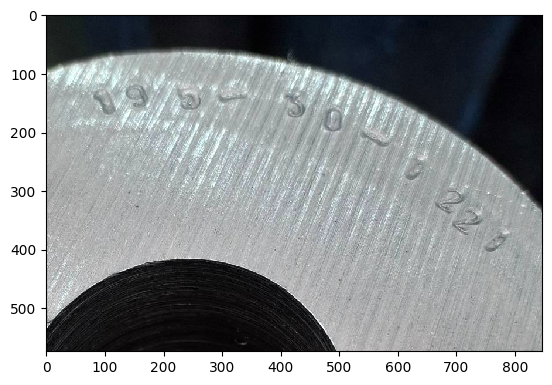

[2024/11/10 11:18:44] ppocr DEBUG: dt_boxes num : 1, elapsed : 0.08816647529602051
[2024/11/10 11:18:44] ppocr DEBUG: cls num  : 1, elapsed : 0.0046617984771728516
[2024/11/10 11:18:44] ppocr DEBUG: rec_res num  : 1, elapsed : 0.022766590118408203
RESULT [None]

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.8ms
Speed: 1.0ms preprocess, 6.8ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.43509     0.49944     0.52607     0.29785]]
COORD 165 670 449 830
CROP (381, 505, 3)


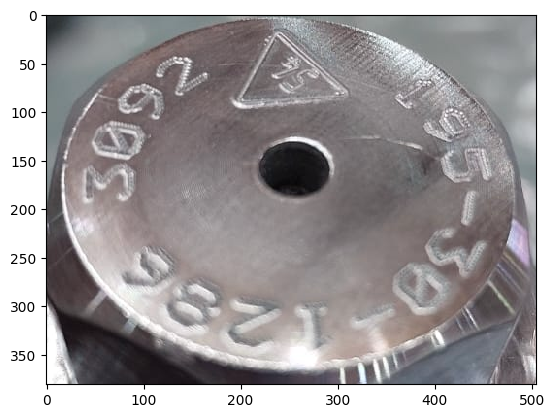

[2024/11/10 11:18:45] ppocr DEBUG: dt_boxes num : 4, elapsed : 0.050176143646240234
[2024/11/10 11:18:45] ppocr DEBUG: cls num  : 4, elapsed : 0.011150836944580078
[2024/11/10 11:18:45] ppocr DEBUG: rec_res num  : 4, elapsed : 0.08004903793334961
RESULT [[[[[72.0, 41.0], [142.0, 65.0], [89.0, 216.0], [19.0, 192.0]], ('500', 0.5655750632286072)], [[[96.0, 222.0], [202.0, 290.0], [169.0, 342.0], [63.0, 275.0]], ('98', 0.9736816883087158)]]]
[        410       410.5       410.5      423.95      423.95      431.01      434.58      441.66      441.66      441.94]
223
РАСПОЗНАННЫЙ ТЕКСТ: 500 98
МАРКИРОВКА: "АНЕМ.492664.500-03.LP 497/5"
0.35717082023620605

IMAGE SIZE; (3024, 4032)

0: 640x480 4 markings, 6.3ms
Speed: 1.5ms preprocess, 6.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.78603     0.39831     0.15553    0.040124]
 [     0.6526     0.33751     0.42811    0.056345]
 [    0.78134     0.39886       0.161    0.054466]
 [    0.66604     0.64015    

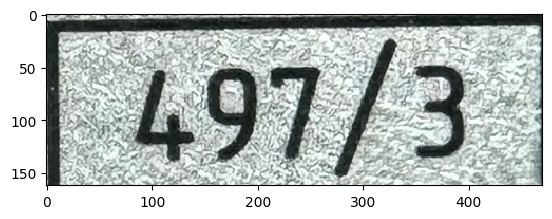

[2024/11/10 11:18:45] ppocr DEBUG: dt_boxes num : 1, elapsed : 0.0356755256652832
[2024/11/10 11:18:45] ppocr DEBUG: cls num  : 1, elapsed : 0.004233837127685547
[2024/11/10 11:18:45] ppocr DEBUG: rec_res num  : 1, elapsed : 0.02210235595703125
RESULT [[[[[75.0, 38.0], [401.0, 25.0], [405.0, 138.0], [79.0, 150.0]], ('497/3', 0.9986037015914917)]]]
[     229.55      229.55       251.8       251.8      275.74       300.9      405.98      407.58      425.15      425.15]
47
РАСПОЗНАННЫЙ ТЕКСТ: 497/3
МАРКИРОВКА: "АНЕМ.492664.500-03LP 497/1"
0.3162500858306885

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 0.9ms preprocess, 6.3ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.51988     0.40681     0.79761     0.26798]]
COORD 116 882 349 692
CROP (343, 766, 3)


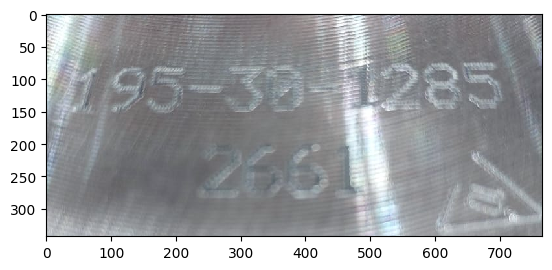

[2024/11/10 11:18:45] ppocr DEBUG: dt_boxes num : 4, elapsed : 0.04731392860412598
[2024/11/10 11:18:45] ppocr DEBUG: cls num  : 4, elapsed : 0.005287885665893555
[2024/11/10 11:18:45] ppocr DEBUG: rec_res num  : 4, elapsed : 0.07208442687988281
RESULT [[[[[374.0, 68.0], [706.0, 68.0], [706.0, 154.0], [374.0, 154.0]], ('41285', 0.8873915672302246)], [[[86.0, 80.0], [413.0, 74.0], [414.0, 150.0], [88.0, 156.0]], ('95-30', 0.948764443397522)], [[[236.0, 196.0], [433.0, 192.0], [434.0, 284.0], [238.0, 288.0]], ('266', 0.7982015609741211)]]]
[     133.67      151.84       152.2      152.37      152.37      152.37      152.66      154.18      154.18      154.95]
72
РАСПОЗНАННЫЙ ТЕКСТ: 41285 95-30 266
МАРКИРОВКА: "195-30-1285 2646"
0.3592662811279297

IMAGE SIZE; (1280, 960)

0: 480x640 1 marking, 6.2ms
Speed: 0.9ms preprocess, 6.2ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.58584     0.56897     0.74293     0.85919]]
COORD 274 1225 134 959
CROP (825, 9

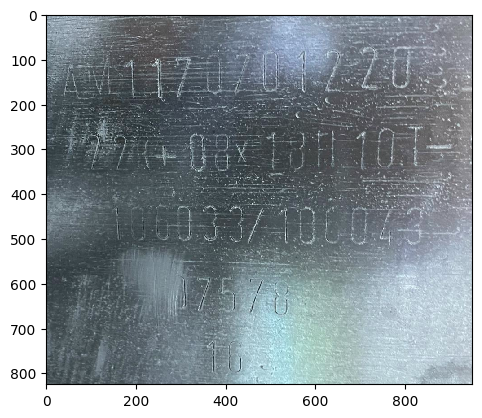

[2024/11/10 11:18:46] ppocr DEBUG: dt_boxes num : 5, elapsed : 0.12369203567504883
[2024/11/10 11:18:46] ppocr DEBUG: cls num  : 5, elapsed : 0.01199030876159668
[2024/11/10 11:18:46] ppocr DEBUG: rec_res num  : 5, elapsed : 0.11121320724487305
RESULT [[[[[30.0, 98.0], [811.0, 64.0], [815.0, 165.0], [35.0, 200.0]], ('A1170701220', 0.8977890014648438)], [[[69.0, 253.0], [846.0, 247.0], [847.0, 353.0], [70.0, 359.0]], ('+08x1810', 0.8011398315429688)], [[[144.0, 415.0], [835.0, 429.0], [833.0, 520.0], [142.0, 506.0]], ('106033/100043', 0.9398390054702759)], [[[285.0, 582.0], [542.0, 591.0], [539.0, 669.0], [282.0, 661.0]], ('07578', 0.8099521398544312)]]]
[     336.37      336.86       352.5       352.5       352.5      370.55      379.44      386.27      388.17      388.17]
17
РАСПОЗНАННЫЙ ТЕКСТ: A1170701220 +08x1810 106033/100043 07578
МАРКИРОВКА: "АМ117.07.01.300 10"
0.6376559734344482

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.5ms
Speed: 0.9ms preprocess, 6.5ms inference, 0.5m

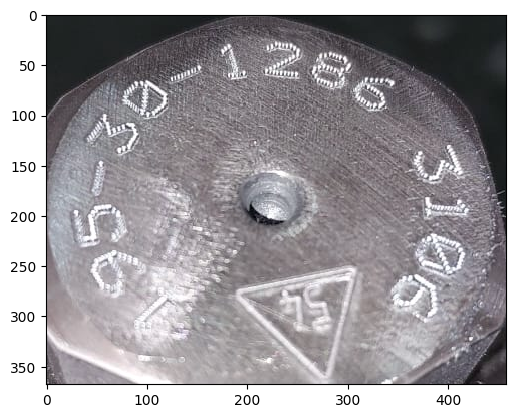

[2024/11/10 11:18:46] ppocr DEBUG: dt_boxes num : 3, elapsed : 0.04573869705200195
[2024/11/10 11:18:46] ppocr DEBUG: cls num  : 3, elapsed : 0.010048866271972656
[2024/11/10 11:18:46] ppocr DEBUG: rec_res num  : 3, elapsed : 0.06503605842590332
RESULT [[[[[269.0, 25.0], [360.0, 63.0], [337.0, 110.0], [246.0, 72.0]], ('86', 0.8929709196090698)], [[[364.0, 121.0], [437.0, 130.0], [411.0, 310.0], [338.0, 301.0]], ('3105', 0.9890618920326233)]]]
[     199.47      209.94      209.94      246.38      268.77       273.6      274.88      275.64      275.64      277.77]
40
РАСПОЗНАННЫЙ ТЕКСТ: 86 3105
МАРКИРОВКА: "195-30-1286 3105"
0.3359067440032959

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 0.9ms preprocess, 6.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.58101     0.42022     0.63443     0.24705]]
COORD 253 862 380 696
CROP (316, 609, 3)


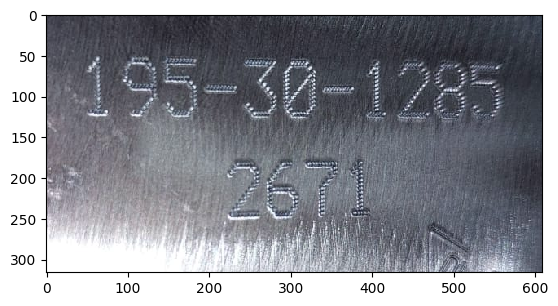

[2024/11/10 11:18:47] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.05286359786987305
[2024/11/10 11:18:47] ppocr DEBUG: cls num  : 2, elapsed : 0.004597663879394531
[2024/11/10 11:18:47] ppocr DEBUG: rec_res num  : 2, elapsed : 0.05151844024658203
RESULT [[[[[50.0, 49.0], [560.0, 54.0], [559.0, 131.0], [49.0, 126.0]], ('195-30-1285', 0.9341655373573303)], [[[216.0, 171.0], [404.0, 171.0], [404.0, 255.0], [216.0, 255.0]], ('2671', 0.9917677640914917)]]]
[          0      33.108      35.256      42.119      47.409      48.495      48.495      48.565      48.565      51.739]
224
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1285 2671
МАРКИРОВКА: "195-30-1285 2671"
0.3369872570037842

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.5ms
Speed: 0.9ms preprocess, 6.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.43494     0.58659     0.86989     0.72267]]
COORD 0 835 288 1213
CROP (925, 835, 3)


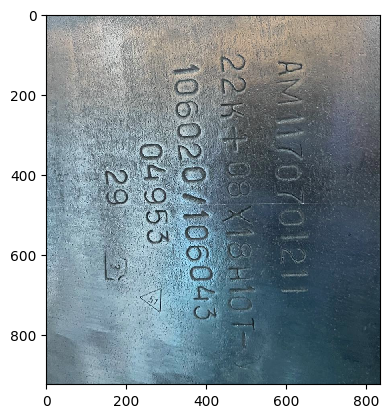

[2024/11/10 11:18:47] ppocr DEBUG: dt_boxes num : 6, elapsed : 0.12201404571533203
[2024/11/10 11:18:47] ppocr DEBUG: cls num  : 6, elapsed : 0.012798070907592773
[2024/11/10 11:18:47] ppocr DEBUG: rec_res num  : 6, elapsed : 0.12960505485534668
RESULT [[[[[420.0, 93.0], [512.0, 90.0], [536.0, 798.0], [444.0, 801.0]], ('22K-+08X18H10T', 0.8510298132896423)], [[[552.0, 99.0], [656.0, 97.0], [668.0, 701.0], [565.0, 703.0]], ('AM1170701211', 0.9444652199745178)], [[[302.0, 120.0], [391.0, 114.0], [438.0, 771.0], [350.0, 777.0]], ('106020/106043', 0.9917866587638855)]]]
[     307.67      346.79      375.29      377.02      379.28      379.28      379.28      379.28      379.28      379.28]
20
РАСПОЗНАННЫЙ ТЕКСТ: 22K-+08X18H10T AM1170701211 106020/106043
МАРКИРОВКА: "АМ117.07.01.452 10"
0.6517360210418701

IMAGE SIZE; (4032, 3024)

0: 480x640 1 marking, 6.2ms
Speed: 1.5ms preprocess, 6.2ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.58369     0.36478    

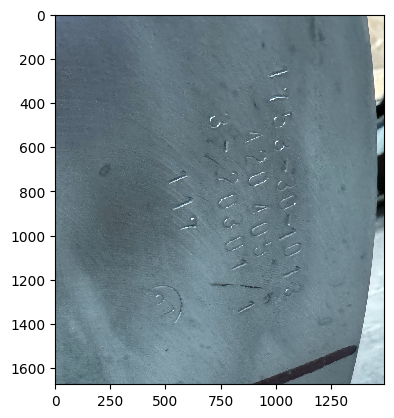

[2024/11/10 11:18:48] ppocr DEBUG: dt_boxes num : 3, elapsed : 0.11705207824707031
[2024/11/10 11:18:48] ppocr DEBUG: cls num  : 3, elapsed : 0.00582432746887207
[2024/11/10 11:18:48] ppocr DEBUG: rec_res num  : 3, elapsed : 0.05708479881286621
RESULT [[[[[854.0, 647.0], [956.0, 640.0], [989.0, 1105.0], [887.0, 1113.0]], ('UAUS', 0.6660110950469971)], [[[987.0, 693.0], [1076.0, 685.0], [1112.0, 1095.0], [1022.0, 1103.0]], ('30010', 0.6212424635887146)], [[[719.0, 730.0], [816.0, 716.0], [874.0, 1136.0], [777.0, 1150.0]], ('7030', 0.6069766283035278)]]]
[     352.29      352.29      352.29      359.17      361.93      361.93       362.8      368.95       372.8       372.8]
121
РАСПОЗНАННЫЙ ТЕКСТ: UAUS 30010 7030
МАРКИРОВКА: "1753-30-1061"
0.7743062973022461

IMAGE SIZE; (1200, 1600)

0: 640x480 1 marking, 6.7ms
Speed: 1.1ms preprocess, 6.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[     0.4927     0.39742     0.63409     0.24295]]
COORD 211 972 442 830


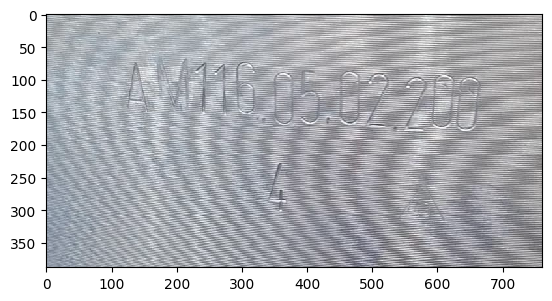

[2024/11/10 11:18:48] ppocr DEBUG: dt_boxes num : 1, elapsed : 0.05826616287231445
[2024/11/10 11:18:48] ppocr DEBUG: cls num  : 1, elapsed : 0.00952005386352539
[2024/11/10 11:18:48] ppocr DEBUG: rec_res num  : 1, elapsed : 0.033879756927490234
RESULT [[[[[131.0, 65.0], [662.0, 100.0], [657.0, 179.0], [126.0, 145.0]], ('A11605.02200', 0.881354808807373)]]]
[      248.2       248.2       248.2      252.49       278.8      302.48      302.48      302.48      302.48      302.48]
191
РАСПОЗНАННЫЙ ТЕКСТ: A11605.02200
МАРКИРОВКА: "АМ116.05.02.200 1"
0.3488645553588867

IMAGE SIZE; (1280, 960)

0: 480x640 2 markings, 6.0ms
Speed: 1.0ms preprocess, 6.0ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.47054     0.45486      0.6306     0.48054]
 [     0.4759     0.38002     0.63661     0.31328]]
COORD 199 1006 206 667
CROP (461, 807, 3)


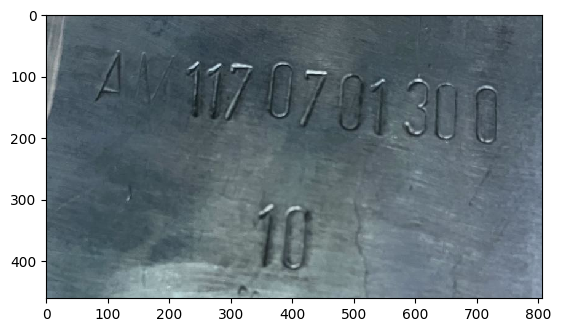

[2024/11/10 11:18:49] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.07714366912841797
[2024/11/10 11:18:49] ppocr DEBUG: cls num  : 2, elapsed : 0.003332853317260742
[2024/11/10 11:18:49] ppocr DEBUG: rec_res num  : 2, elapsed : 0.039109230041503906
RESULT [[[[[82.0, 50.0], [740.0, 113.0], [731.0, 216.0], [73.0, 153.0]], ('AM1170701300', 0.9259934425354004)], [[[339.0, 307.0], [440.0, 307.0], [440.0, 417.0], [339.0, 417.0]], ('10', 0.9912924766540527)]]]
[      104.2      133.53      269.93      269.93      273.67      283.27      283.27      283.27       321.5      341.85]
17
РАСПОЗНАННЫЙ ТЕКСТ: AM1170701300 10
МАРКИРОВКА: "АМ117.07.01.300 10"
0.3620119094848633

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 7.4ms
Speed: 0.9ms preprocess, 7.4ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.54766     0.48632     0.67594     0.23966]]
COORD 201 850 469 776
CROP (307, 649, 3)


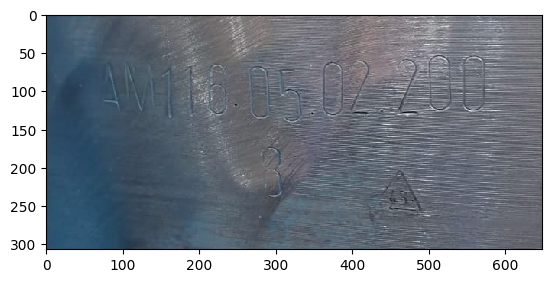

[2024/11/10 11:18:49] ppocr DEBUG: dt_boxes num : 1, elapsed : 0.05531907081604004
[2024/11/10 11:18:49] ppocr DEBUG: cls num  : 1, elapsed : 0.004328012466430664
[2024/11/10 11:18:49] ppocr DEBUG: rec_res num  : 1, elapsed : 0.0238800048828125
RESULT [[[[[69.0, 59.0], [584.0, 50.0], [586.0, 133.0], [70.0, 141.0]], ('1M116.05.02-200', 0.8077647686004639)]]]
[     160.99      160.99      160.99      191.17      204.09      204.09      222.34      222.34      222.34      268.07]
191
РАСПОЗНАННЫЙ ТЕКСТ: 1M116.05.02-200
МАРКИРОВКА: "АМ116.05.02.200 1"
0.3052341938018799

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 0.9ms preprocess, 6.3ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.46271     0.22372     0.66596     0.18971]]
COORD 125 764 165 408
CROP (243, 639, 3)


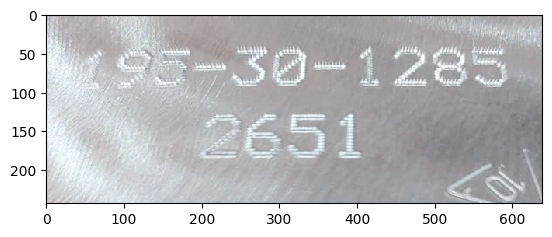

[2024/11/10 11:18:49] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.050766944885253906
[2024/11/10 11:18:49] ppocr DEBUG: cls num  : 2, elapsed : 0.0031561851501464844
[2024/11/10 11:18:49] ppocr DEBUG: rec_res num  : 2, elapsed : 0.06514310836791992
RESULT [[[[[49.0, 40.0], [592.0, 38.0], [592.0, 93.0], [49.0, 95.0]], ('05-30128', 0.6953914761543274)], [[[197.0, 122.0], [409.0, 122.0], [409.0, 190.0], [197.0, 190.0]], ('651', 0.9952729344367981)]]]
[     201.87      218.78         225         225      226.17      230.36      230.66      231.44      231.69      241.03]
249
РАСПОЗНАННЫЙ ТЕКСТ: 05-30128 651
МАРКИРОВКА: "195-30-1221 3583-3594"
0.32184314727783203

IMAGE SIZE; (1600, 1200)

0: 480x640 1 marking, 6.2ms
Speed: 1.1ms preprocess, 6.2ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.48658     0.55494     0.73839     0.80665]]
COORD 188 1369 182 1150
CROP (968, 1181, 3)


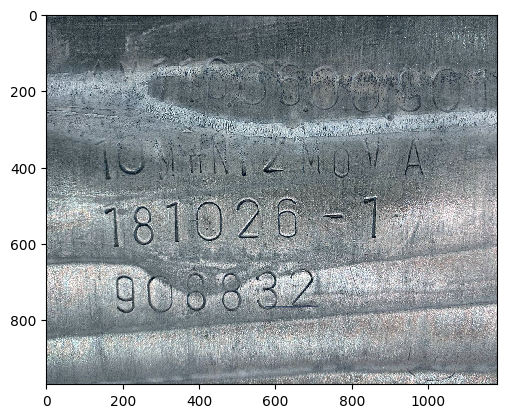

[2024/11/10 11:18:50] ppocr DEBUG: dt_boxes num : 3, elapsed : 0.12531709671020508
[2024/11/10 11:18:50] ppocr DEBUG: cls num  : 3, elapsed : 0.010711908340454102
[2024/11/10 11:18:50] ppocr DEBUG: rec_res num  : 3, elapsed : 0.07009506225585938
RESULT [[[[[139.0, 312.0], [988.0, 312.0], [988.0, 427.0], [139.0, 427.0]], ('IONHNTZMOVA', 0.6392316818237305)], [[[151.0, 488.0], [879.0, 458.0], [885.0, 583.0], [156.0, 613.0]], ('181026-7', 0.9106818437576294)], [[[170.0, 670.0], [710.0, 661.0], [712.0, 775.0], [172.0, 783.0]], ('908832', 0.9069729447364807)]]]
[     366.12      373.82       377.9       377.9       377.9       377.9       377.9       377.9       377.9       377.9]
232
РАСПОЗНАННЫЙ ТЕКСТ: IONHNTZMOVA 181026-7 908832
МАРКИРОВКА: "195-30-0109 242"
0.671119213104248

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.9ms
Speed: 0.9ms preprocess, 6.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.46996     0.47008     0.48165     0.30283]]
COORD

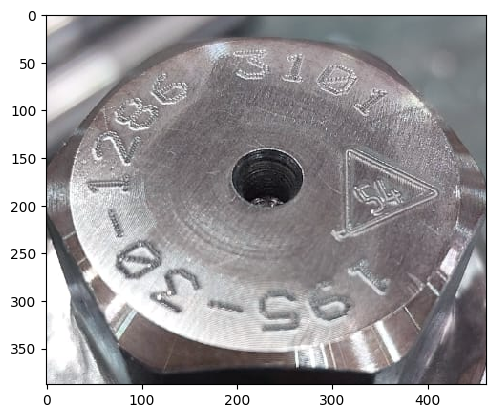

[2024/11/10 11:18:50] ppocr DEBUG: dt_boxes num : 4, elapsed : 0.045682430267333984
[2024/11/10 11:18:50] ppocr DEBUG: cls num  : 4, elapsed : 0.011016845703125
[2024/11/10 11:18:50] ppocr DEBUG: rec_res num  : 4, elapsed : 0.08062314987182617
RESULT [[[[[219.0, 286.0], [279.0, 286.0], [279.0, 334.0], [219.0, 334.0]], ('S', 0.7957119941711426)]]]
[     512.08      527.06      527.06      529.08      532.45      532.45      532.82      537.23      537.23      537.28]
232
РАСПОЗНАННЫЙ ТЕКСТ: S
МАРКИРОВКА: "195-30-0109 242"
0.34690332412719727

IMAGE SIZE; (1530, 2040)

0: 640x480 (no detections), 6.8ms
Speed: 1.1ms preprocess, 6.8ms inference, 0.3ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH []
CROP (2040, 1530, 3)


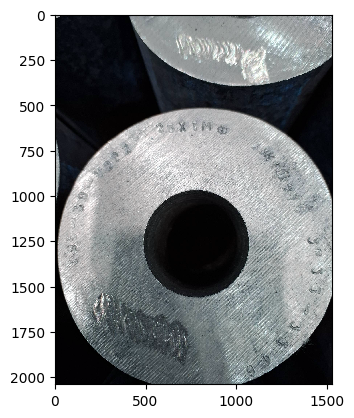

[2024/11/10 11:18:51] ppocr DEBUG: dt_boxes num : 5, elapsed : 0.10998177528381348
[2024/11/10 11:18:51] ppocr DEBUG: cls num  : 5, elapsed : 0.011781692504882812
[2024/11/10 11:18:51] ppocr DEBUG: rec_res num  : 5, elapsed : 0.10208725929260254
RESULT [[[[[553.0, 580.0], [957.0, 587.0], [955.0, 670.0], [552.0, 663.0]], ('25XM0', 0.7295638918876648)], [[[1389.0, 1219.0], [1491.0, 1221.0], [1486.0, 1567.0], [1384.0, 1565.0]], ('3035', 0.7997838258743286)]]]
[     367.59      369.32      369.32       372.6       372.6         374      375.23      375.23      376.48      386.64]
40
РАСПОЗНАННЫЙ ТЕКСТ: 25XM0 3035
МАРКИРОВКА: "195-30-1286 3105"
0.8817875385284424

IMAGE SIZE; (1280, 960)

0: 480x640 1 marking, 6.0ms
Speed: 0.9ms preprocess, 6.0ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.59045     0.49353     0.25521     0.48176]]
COORD 592 919 243 705
CROP (462, 327, 3)


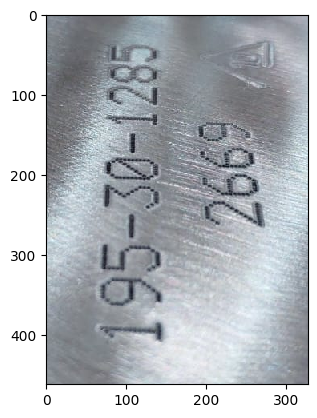

[2024/11/10 11:18:51] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.04053521156311035
[2024/11/10 11:18:51] ppocr DEBUG: cls num  : 2, elapsed : 0.004546165466308594
[2024/11/10 11:18:52] ppocr DEBUG: rec_res num  : 2, elapsed : 0.049807071685791016
RESULT [[[[[57.0, 30.0], [154.0, 30.0], [154.0, 416.0], [57.0, 416.0]], ('195-30-1285', 0.9942737817764282)], [[[175.0, 121.0], [273.0, 116.0], [280.0, 272.0], [182.0, 277.0]], ('2669', 0.9961307048797607)]]]
[          0           0      21.884      21.884      22.838      35.534      35.534      41.621      42.232      42.232]
201
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1285 2669
МАРКИРОВКА: "195-30-1285 2669"
0.30713820457458496

IMAGE SIZE; (1204, 1600)

0: 640x512 1 marking, 28.7ms
Speed: 1.1ms preprocess, 28.7ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 512)
BBOX WH [[    0.45701     0.51772     0.86497     0.52575]]
COORD 30 1071 408 1249
CROP (841, 1041, 3)


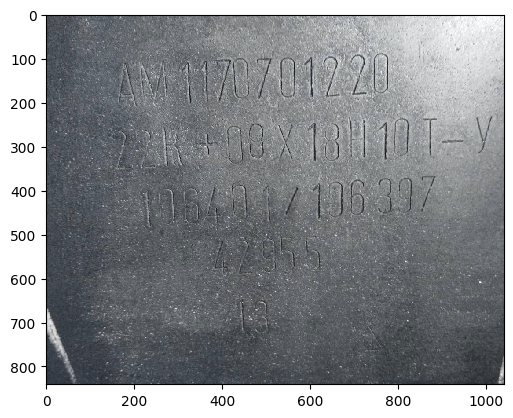

[2024/11/10 11:18:52] ppocr DEBUG: dt_boxes num : 4, elapsed : 0.12023115158081055
[2024/11/10 11:18:52] ppocr DEBUG: cls num  : 4, elapsed : 0.005627632141113281
[2024/11/10 11:18:52] ppocr DEBUG: rec_res num  : 4, elapsed : 0.10723519325256348
RESULT [[[[[166.0, 110.0], [779.0, 87.0], [782.0, 181.0], [170.0, 205.0]], ('A1170701220', 0.9346515536308289)], [[[141.0, 258.0], [1012.0, 227.0], [1015.0, 320.0], [144.0, 351.0]], ('7+08X13H10T-y', 0.7965462803840637)], [[[214.0, 397.0], [885.0, 363.0], [889.0, 450.0], [218.0, 483.0]], ('116401/106:397', 0.8313469886779785)], [[[362.0, 508.0], [630.0, 497.0], [634.0, 583.0], [365.0, 593.0]], ('77.955', 0.7368378043174744)]]]
[     284.05      289.11      289.11      289.11      291.47      357.36      366.04      366.04      368.38      368.38]
17
РАСПОЗНАННЫЙ ТЕКСТ: A1170701220 7+08X13H10T-y 116401/106:397 77.955
МАРКИРОВКА: "АМ117.07.01.300 10"
0.6899716854095459

IMAGE SIZE; (1280, 960)

0: 480x640 2 markings, 6.1ms
Speed: 0.9ms preprocess

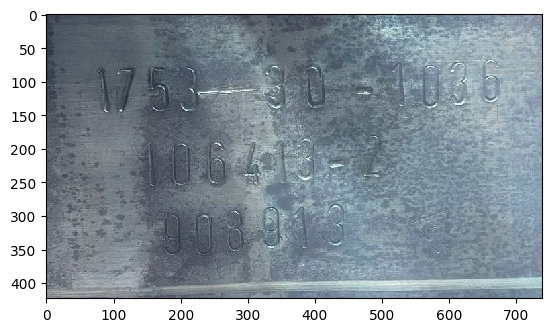

[2024/11/10 11:18:53] ppocr DEBUG: dt_boxes num : 4, elapsed : 0.0693807601928711
[2024/11/10 11:18:53] ppocr DEBUG: cls num  : 4, elapsed : 0.005331754684448242
[2024/11/10 11:18:53] ppocr DEBUG: rec_res num  : 4, elapsed : 0.0924677848815918
RESULT [[[[[70.0, 74.0], [679.0, 59.0], [680.0, 136.0], [72.0, 150.0]], ('1753-30-1036', 0.922982931137085)], [[[117.0, 186.0], [521.0, 168.0], [524.0, 245.0], [120.0, 263.0]], ('106413-2', 0.9142124652862549)], [[[161.0, 291.0], [450.0, 278.0], [453.0, 345.0], [163.0, 358.0]], ('908913', 0.9445837140083313)]]]
[     169.08      169.08      206.18      216.06      216.06      216.06      239.45      239.45      239.45      239.45]
120
РАСПОЗНАННЫЙ ТЕКСТ: 1753-30-1036 106413-2 908913
МАРКИРОВКА: "1753-30-1036 2"
0.447185754776001

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.5ms
Speed: 0.9ms preprocess, 6.5ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.41857     0.32727     0.67422     0.20012]]
COORD 78 72

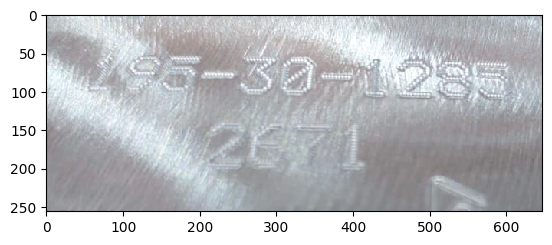

[2024/11/10 11:18:53] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.050177812576293945
[2024/11/10 11:18:53] ppocr DEBUG: cls num  : 2, elapsed : 0.00883793830871582
[2024/11/10 11:18:53] ppocr DEBUG: rec_res num  : 2, elapsed : 0.05595040321350098
RESULT [[[[[108.0, 37.0], [606.0, 58.0], [604.0, 119.0], [105.0, 98.0]], ('05-30-1086', 0.6951268911361694)]]]
[     150.26      150.26      159.73      159.73       163.9      165.47      165.47      165.47      166.29      166.29]
26
РАСПОЗНАННЫЙ ТЕКСТ: 05-30-1086
МАРКИРОВКА: "195-30-1286 3085"
0.31722593307495117

IMAGE SIZE; (1600, 1200)

0: 480x640 1 marking, 6.4ms
Speed: 1.0ms preprocess, 6.4ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.43439      0.5976     0.73722      0.8048]]
COORD 105 1285 234 1200
CROP (966, 1180, 3)


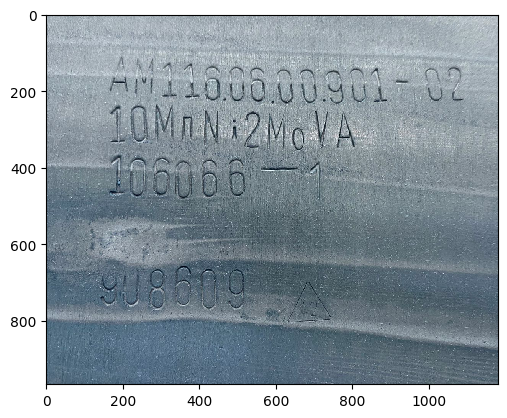

[2024/11/10 11:18:54] ppocr DEBUG: dt_boxes num : 4, elapsed : 0.12431073188781738
[2024/11/10 11:18:54] ppocr DEBUG: cls num  : 4, elapsed : 0.0057904720306396484
[2024/11/10 11:18:54] ppocr DEBUG: rec_res num  : 4, elapsed : 0.08280611038208008
RESULT [[[[[162.0, 89.0], [1102.0, 118.0], [1098.0, 256.0], [157.0, 227.0]], ('AM116.06.00.901-02', 0.9556117653846741)], [[[165.0, 229.0], [815.0, 254.0], [811.0, 362.0], [161.0, 338.0]], ('10MnN2MoVA', 0.8602835536003113)], [[[168.0, 366.0], [530.0, 376.0], [526.0, 484.0], [165.0, 474.0]], ('106066', 0.9905324578285217)], [[[146.0, 655.0], [530.0, 664.0], [528.0, 770.0], [143.0, 761.0]], ('908609', 0.9322450160980225)]]]
[     213.54      224.41      224.41      224.41      224.41      224.41      224.41      224.49      224.49      224.49]
125
РАСПОЗНАННЫЙ ТЕКСТ: AM116.06.00.901-02 10MnN2MoVA 106066 908609
МАРКИРОВКА: "АМ116.06.00.901-02 2"
0.6905274391174316

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.7ms
Speed: 0.9ms preprocess, 6.7

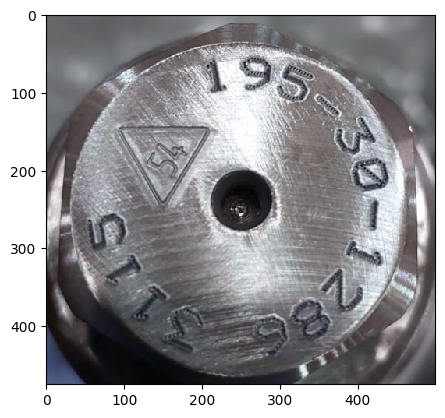

[2024/11/10 11:18:54] ppocr DEBUG: dt_boxes num : 1, elapsed : 0.05362892150878906
[2024/11/10 11:18:54] ppocr DEBUG: cls num  : 1, elapsed : 0.009256601333618164
[2024/11/10 11:18:54] ppocr DEBUG: rec_res num  : 1, elapsed : 0.03112506866455078
RESULT [None]

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 0.9ms preprocess, 6.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.52548     0.43729      0.9176     0.73752]]
COORD 64 945 88 1032
CROP (944, 881, 3)


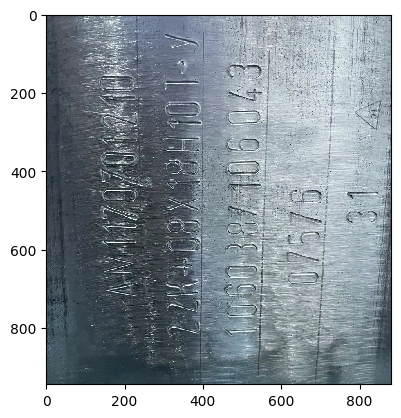

[2024/11/10 11:18:54] ppocr DEBUG: dt_boxes num : 4, elapsed : 0.14691853523254395
[2024/11/10 11:18:54] ppocr DEBUG: cls num  : 4, elapsed : 0.0063211917877197266
[2024/11/10 11:18:54] ppocr DEBUG: rec_res num  : 4, elapsed : 0.08594775199890137
RESULT [[[[[448.0, 100.0], [570.0, 102.0], [558.0, 750.0], [436.0, 748.0]], ('6038/106043', 0.9356356263160706)], [[[614.0, 423.0], [723.0, 431.0], [703.0, 694.0], [594.0, 686.0]], ('07576', 0.9685356020927429)]]]
[     361.29      361.29      378.15      378.15      387.24      387.24      399.94      399.94      400.88      400.88]
160
РАСПОЗНАННЫЙ ТЕКСТ: 6038/106043 07576
МАРКИРОВКА: "АМ116.05.02.201 7"
0.5903036594390869

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.5ms
Speed: 0.8ms preprocess, 6.5ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.50487     0.48557     0.45134     0.31379]]
COORD 268 701 421 822
CROP (401, 433, 3)


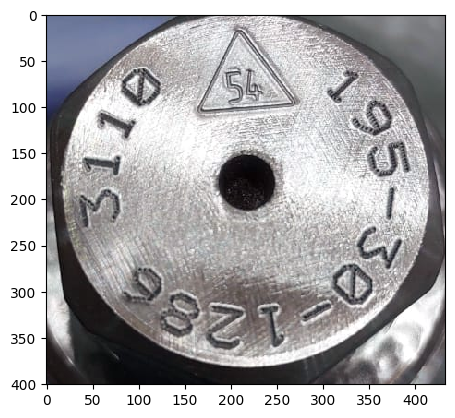

[2024/11/10 11:18:55] ppocr DEBUG: dt_boxes num : 4, elapsed : 0.04823589324951172
[2024/11/10 11:18:55] ppocr DEBUG: cls num  : 4, elapsed : 0.006018161773681641
[2024/11/10 11:18:55] ppocr DEBUG: rec_res num  : 4, elapsed : 0.07128620147705078
RESULT [[[[[195.0, 59.0], [237.0, 62.0], [234.0, 93.0], [193.0, 90.0]], ('54', 0.9770310521125793)], [[[293.0, 69.0], [355.0, 43.0], [410.0, 173.0], [348.0, 199.0]], ('195', 0.9976231455802917)]]]
[     361.54      361.54      400.45      400.45      404.87      406.41      406.41      409.27      414.85      414.93]
87
РАСПОЗНАННЫЙ ТЕКСТ: 54 195
МАРКИРОВКА: "195-30-1285 2654"
0.34267210960388184

IMAGE SIZE; (2856, 2142)

0: 480x640 1 marking, 6.2ms
Speed: 1.4ms preprocess, 6.2ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.49054      0.4798     0.41032     0.49409]]
COORD 815 1987 499 1557
CROP (1058, 1172, 3)


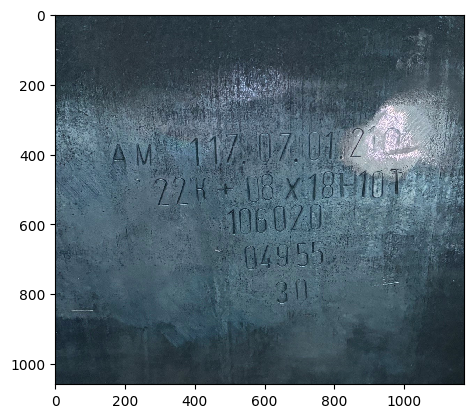

[2024/11/10 11:18:55] ppocr DEBUG: dt_boxes num : 5, elapsed : 0.13071537017822266
[2024/11/10 11:18:55] ppocr DEBUG: cls num  : 5, elapsed : 0.011456727981567383
[2024/11/10 11:18:56] ppocr DEBUG: rec_res num  : 5, elapsed : 0.11876606941223145
RESULT [[[[[277.0, 463.0], [1057.0, 434.0], [1061.0, 526.0], [281.0, 554.0]], ('0X80+H77', 0.567952573299408)], [[[491.0, 556.0], [787.0, 541.0], [790.0, 615.0], [494.0, 629.0]], ('106020', 0.991260290145874)], [[[529.0, 648.0], [780.0, 636.0], [784.0, 723.0], [533.0, 735.0]], ('049.55', 0.9070441722869873)], [[[617.0, 753.0], [733.0, 747.0], [737.0, 833.0], [621.0, 839.0]], ('30', 0.9306588172912598)]]]
[     309.74      314.06      315.06      315.06       323.5       323.5      323.78      324.19      325.87      326.23]
40
РАСПОЗНАННЫЙ ТЕКСТ: 0X80+H77 106020 049.55 30
МАРКИРОВКА: "195-30-1286 3105"
0.7461302280426025

IMAGE SIZE; (1280, 960)

0: 480x640 1 marking, 5.8ms
Speed: 0.9ms preprocess, 5.8ms inference, 0.5ms postprocess per image a

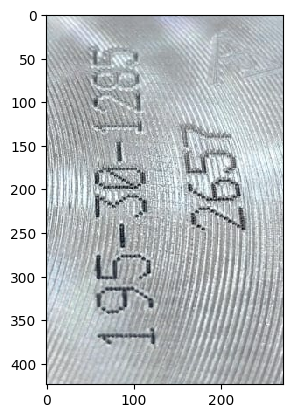

[2024/11/10 11:18:56] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.03377389907836914
[2024/11/10 11:18:56] ppocr DEBUG: cls num  : 2, elapsed : 0.009617805480957031
[2024/11/10 11:18:56] ppocr DEBUG: rec_res num  : 2, elapsed : 0.05239510536193848
RESULT [[[[[29.0, 31.0], [114.0, 26.0], [136.0, 385.0], [51.0, 390.0]], ('195-30-1285', 0.9459593296051025)], [[[143.0, 121.0], [225.0, 114.0], [237.0, 252.0], [155.0, 259.0]], ('2657', 0.9983044862747192)]]]
[          0      33.263      33.263      37.528      37.528      38.138      43.694      43.694      43.694      44.915]
95
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1285 2657
МАРКИРОВКА: "195-30-1285 2657"
0.3044576644897461

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.7ms
Speed: 0.9ms preprocess, 6.7ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.42044     0.40005     0.56855     0.17446]]
COORD 131 677 400 624
CROP (224, 546, 3)


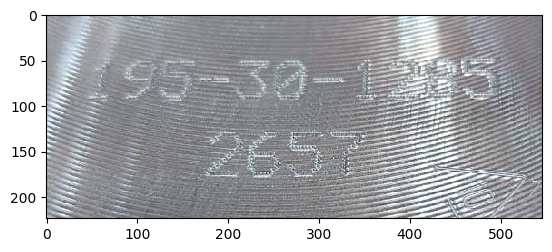

[2024/11/10 11:18:56] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.04340696334838867
[2024/11/10 11:18:56] ppocr DEBUG: cls num  : 2, elapsed : 0.004540920257568359
[2024/11/10 11:18:56] ppocr DEBUG: rec_res num  : 2, elapsed : 0.053603172302246094
RESULT [[[[[23.0, 25.0], [501.0, 42.0], [498.0, 110.0], [20.0, 93.0]], ('195-30-1295', 0.8973483443260193)], [[[169.0, 125.0], [350.0, 123.0], [351.0, 183.0], [170.0, 185.0]], ('2657', 0.9936445355415344)]]]
[     18.411      54.434      54.434      58.924      59.238       60.15       60.15       60.15      61.865      62.885]
95
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1295 2657
МАРКИРОВКА: "195-30-1285 2657"
0.31587958335876465

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.4ms
Speed: 0.9ms preprocess, 6.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.46509     0.31664     0.56614     0.15452]]
COORD 175 718 306 504
CROP (198, 543, 3)


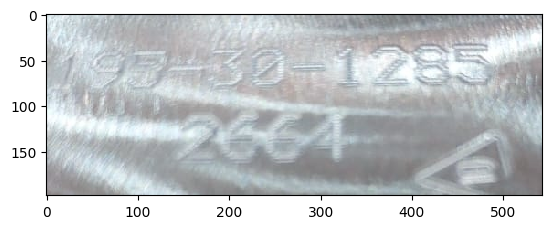

[2024/11/10 11:18:56] ppocr DEBUG: dt_boxes num : 1, elapsed : 0.04045844078063965
[2024/11/10 11:18:56] ppocr DEBUG: cls num  : 1, elapsed : 0.008844137191772461
[2024/11/10 11:18:56] ppocr DEBUG: rec_res num  : 1, elapsed : 0.03178715705871582
RESULT [[[[[220.0, 40.0], [481.0, 28.0], [483.0, 74.0], [222.0, 85.0]], ('01285', 0.9783345460891724)]]]
[     358.78      358.78      361.52      361.52      361.52      361.52      361.52      362.55      362.68      373.33]
161
РАСПОЗНАННЫЙ ТЕКСТ: 01285
МАРКИРОВКА: "1391-30-1140 235"
0.2706112861633301

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 0.9ms preprocess, 6.3ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[     0.4948     0.49742     0.53782     0.20152]]
COORD 217 733 508 766
CROP (258, 516, 3)


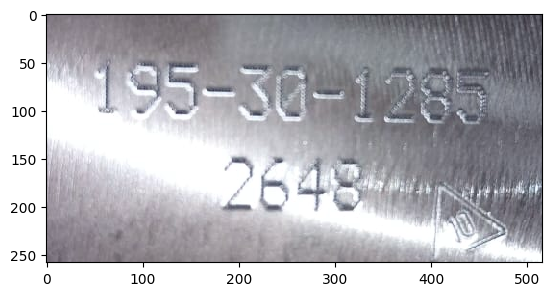

[2024/11/10 11:18:57] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.04333972930908203
[2024/11/10 11:18:57] ppocr DEBUG: cls num  : 2, elapsed : 0.004709482192993164
[2024/11/10 11:18:57] ppocr DEBUG: rec_res num  : 2, elapsed : 0.05137753486633301
RESULT [[[[[50.0, 49.0], [456.0, 56.0], [455.0, 114.0], [49.0, 108.0]], ('195-30-1285', 0.9829065799713135)], [[[183.0, 143.0], [341.0, 148.0], [339.0, 210.0], [181.0, 205.0]], ('2648', 0.9848644733428955)]]]
[          0       32.09       32.09      32.485      32.485      32.635      32.635      32.635      36.462      36.462]
75
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1285 2648
МАРКИРОВКА: "195-30-1285 2648"
0.3055448532104492

IMAGE SIZE; (2856, 2142)

0: 480x640 1 marking, 6.1ms
Speed: 1.2ms preprocess, 6.1ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.49421     0.41894     0.52584     0.49216]]
COORD 661 2162 370 1424
CROP (1054, 1501, 3)


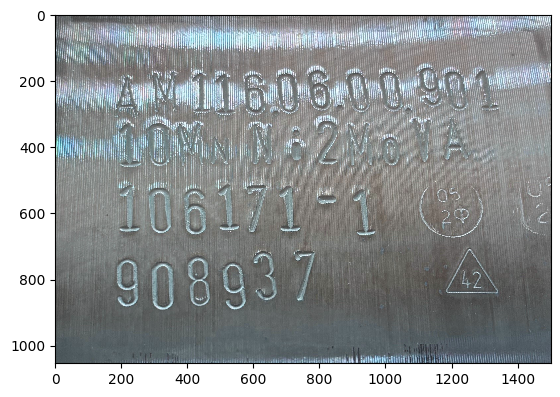

[2024/11/10 11:18:57] ppocr DEBUG: dt_boxes num : 4, elapsed : 0.11173105239868164
[2024/11/10 11:18:57] ppocr DEBUG: cls num  : 4, elapsed : 0.0115203857421875
[2024/11/10 11:18:58] ppocr DEBUG: rec_res num  : 4, elapsed : 0.09845137596130371
RESULT [[[[[197.0, 162.0], [1331.0, 149.0], [1333.0, 287.0], [198.0, 300.0]], ('AM1160600901', 0.8268579840660095)], [[[190.0, 307.0], [1257.0, 316.0], [1256.0, 465.0], [189.0, 456.0]], ('TOMN NO2MOIA', 0.7501223683357239)], [[[188.0, 505.0], [983.0, 505.0], [983.0, 662.0], [188.0, 662.0]], ('106171-1', 0.9866246581077576)], [[[173.0, 735.0], [784.0, 707.0], [792.0, 878.0], [181.0, 906.0]], ('908937', 0.976417064666748)]]]
[     270.59      289.63      293.73      308.76      308.76      308.76      308.76      308.76      308.76      314.38]
184
РАСПОЗНАННЫЙ ТЕКСТ: AM1160600901 TOMN NO2MOIA 106171-1 908937
МАРКИРОВКА: "АМ116.15.00.909 2"
0.8003904819488525

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.7ms
Speed: 1.0ms preprocess, 6.7ms infer

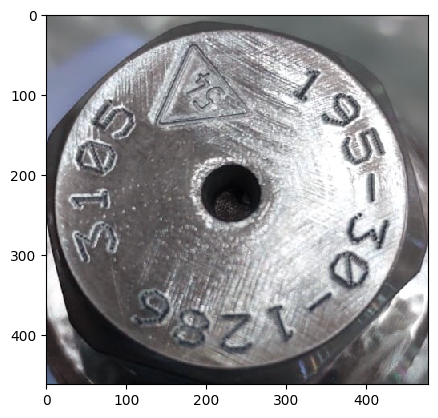

[2024/11/10 11:18:58] ppocr DEBUG: dt_boxes num : 3, elapsed : 0.05352282524108887
[2024/11/10 11:18:58] ppocr DEBUG: cls num  : 3, elapsed : 0.010238409042358398
[2024/11/10 11:18:58] ppocr DEBUG: rec_res num  : 3, elapsed : 0.06544995307922363
RESULT [[[[[28.0, 108.0], [112.0, 114.0], [98.0, 323.0], [14.0, 317.0]], ('3105', 0.800621747970581)]]]
[     206.29      284.16      288.53      288.53      323.63      325.49      338.74      347.14      347.14      352.49]
40
РАСПОЗНАННЫЙ ТЕКСТ: 3105
МАРКИРОВКА: "195-30-1286 3105"
0.346024751663208

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 0.9ms preprocess, 6.3ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.47775     0.47646     0.35482     0.21262]]
COORD 288 629 474 746
CROP (272, 341, 3)


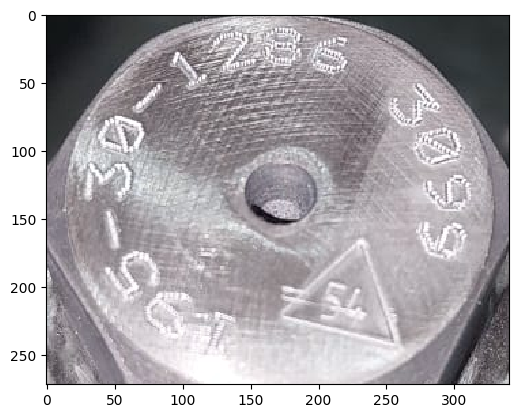

[2024/11/10 11:18:58] ppocr DEBUG: dt_boxes num : 10, elapsed : 0.03528285026550293
[2024/11/10 11:18:58] ppocr DEBUG: cls num  : 10, elapsed : 0.016155242919921875
[2024/11/10 11:18:58] ppocr DEBUG: rec_res num  : 10, elapsed : 0.19160747528076172
RESULT [[[[[47.0, 169.0], [81.0, 169.0], [81.0, 211.0], [47.0, 211.0]], ('S', 0.501176118850708)]]]
[     512.08      527.06      527.06      529.08      532.45      532.45      532.82      537.23      537.23      537.28]
232
РАСПОЗНАННЫЙ ТЕКСТ: S
МАРКИРОВКА: "195-30-0109 242"
0.4242980480194092

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.5ms
Speed: 0.9ms preprocess, 6.5ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.42154     0.49695     0.77792     0.46167]]
COORD 31 778 341 932
CROP (591, 747, 3)


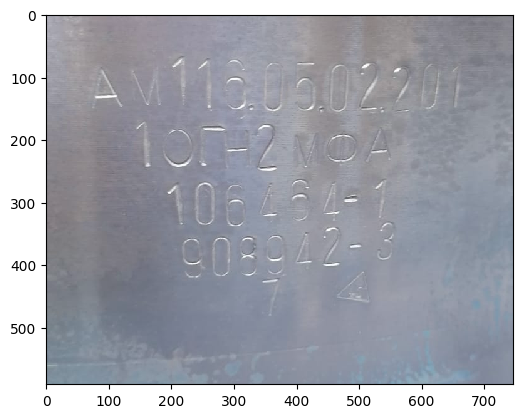

[2024/11/10 11:18:59] ppocr DEBUG: dt_boxes num : 4, elapsed : 0.08268022537231445
[2024/11/10 11:18:59] ppocr DEBUG: cls num  : 4, elapsed : 0.00606989860534668
[2024/11/10 11:18:59] ppocr DEBUG: rec_res num  : 4, elapsed : 0.092041015625
RESULT [[[[[74.0, 67.0], [667.0, 76.0], [666.0, 157.0], [73.0, 148.0]], ('AM11305.02201', 0.9434674382209778)], [[[143.0, 168.0], [558.0, 173.0], [558.0, 251.0], [142.0, 246.0]], ('10-2MOA', 0.7894693613052368)], [[[194.0, 270.0], [540.0, 259.0], [543.0, 328.0], [196.0, 339.0]], ('106464-1', 0.9149406552314758)], [[[211.0, 353.0], [543.0, 333.0], [547.0, 408.0], [215.0, 428.0]], ('-776806', 0.9581847190856934)]]]
[     236.91      275.15       285.6      286.97      296.65      298.31      298.31      298.31      298.31      298.31]
20
РАСПОЗНАННЫЙ ТЕКСТ: AM11305.02201 10-2MOA 106464-1 -776806
МАРКИРОВКА: "АМ117.07.01.452 10"
0.48601508140563965

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.8ms
Speed: 0.9ms preprocess, 6.8ms inference, 0.5ms post

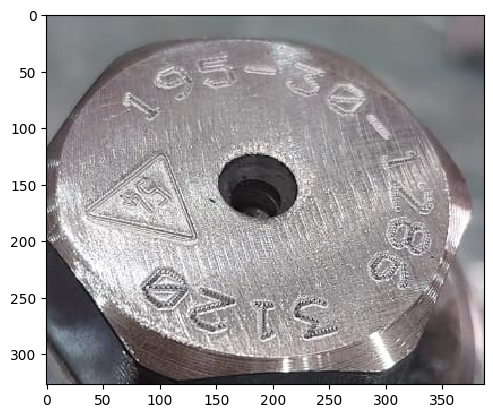

[2024/11/10 11:18:59] ppocr DEBUG: dt_boxes num : 7, elapsed : 0.03575325012207031
[2024/11/10 11:18:59] ppocr DEBUG: cls num  : 7, elapsed : 0.014550447463989258
[2024/11/10 11:18:59] ppocr DEBUG: rec_res num  : 7, elapsed : 0.14005208015441895
RESULT [[[[[290.0, 208.0], [326.0, 221.0], [317.0, 245.0], [282.0, 233.0]], ('OS', 0.548602819442749)]]]
[     533.04      533.39      533.84      533.84      533.84      534.28      534.28      537.16      537.16      537.16]
32
РАСПОЗНАННЫЙ ТЕКСТ: OS
МАРКИРОВКА: "195-30-1286 3092"
0.38668227195739746

IMAGE SIZE; (1280, 960)

0: 480x640 2 markings, 6.5ms
Speed: 1.0ms preprocess, 6.5ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.47995     0.48078     0.35149     0.35628]
 [    0.42912     0.91709     0.36736     0.16569]]
COORD 389 839 291 633
CROP (342, 450, 3)


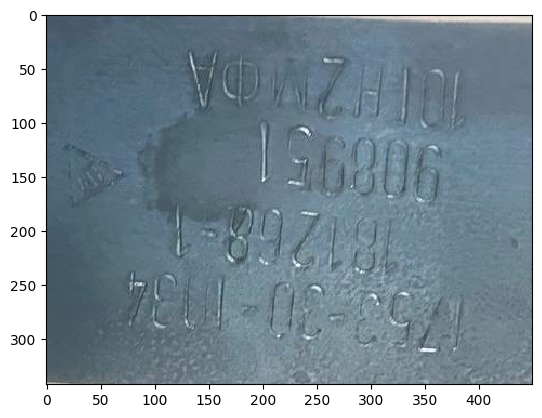

[2024/11/10 11:18:59] ppocr DEBUG: dt_boxes num : 4, elapsed : 0.045453786849975586
[2024/11/10 11:19:00] ppocr DEBUG: cls num  : 4, elapsed : 0.005488157272338867
[2024/11/10 11:19:00] ppocr DEBUG: rec_res num  : 4, elapsed : 0.06913352012634277
RESULT [[[[[131.0, 25.0], [387.0, 46.0], [381.0, 107.0], [126.0, 86.0]], ('IOIH2MOA', 0.6838695406913757)], [[[194.0, 95.0], [374.0, 116.0], [366.0, 179.0], [187.0, 158.0]], ('908951', 0.9956125617027283)], [[[99.0, 164.0], [334.0, 187.0], [328.0, 246.0], [93.0, 223.0]], ('181268-1', 0.9751407504081726)], [[[74.0, 235.0], [386.0, 260.0], [381.0, 313.0], [69.0, 288.0]], ('753-30-1134', 0.9236762523651123)]]]
[      368.9      369.26      372.03      373.25      373.53       374.5       374.5      376.49      376.49      377.79]
39
РАСПОЗНАННЫЙ ТЕКСТ: IOIH2MOA 908951 181268-1 753-30-1134
МАРКИРОВКА: "195-30-1286 3101"
0.3829185962677002

IMAGE SIZE; (960, 1280)

0: 640x480 2 markings, 6.5ms
Speed: 0.9ms preprocess, 6.5ms inference, 0.5ms postpro

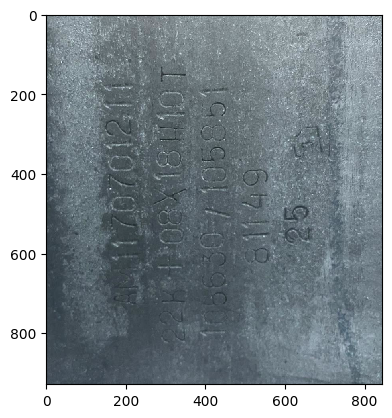

[2024/11/10 11:19:00] ppocr DEBUG: dt_boxes num : 5, elapsed : 0.12227296829223633
[2024/11/10 11:19:00] ppocr DEBUG: cls num  : 5, elapsed : 0.011435747146606445
[2024/11/10 11:19:00] ppocr DEBUG: rec_res num  : 5, elapsed : 0.09717369079589844
RESULT [[[[[282.0, 194.0], [358.0, 200.0], [341.0, 420.0], [264.0, 414.0]], ('011181', 0.657595157623291)], [[[381.0, 197.0], [459.0, 197.0], [459.0, 462.0], [381.0, 462.0]], ('10585', 0.9943122863769531)], [[[149.0, 314.0], [219.0, 309.0], [233.0, 501.0], [163.0, 506.0]], ('0701', 0.9950382709503174)], [[[491.0, 380.0], [559.0, 380.0], [559.0, 522.0], [491.0, 522.0]], ('64', 0.6548503637313843)]]]
[     320.46      320.46      320.46      327.57      327.57      327.57      327.57      340.45      340.45      340.45]
229
РАСПОЗНАННЫЙ ТЕКСТ: 011181 10585 0701 64
МАРКИРОВКА: "1391-30-0109 241"
0.552248477935791

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 0.8ms preprocess, 6.3ms inference, 0.5ms postprocess per image at shape (1,

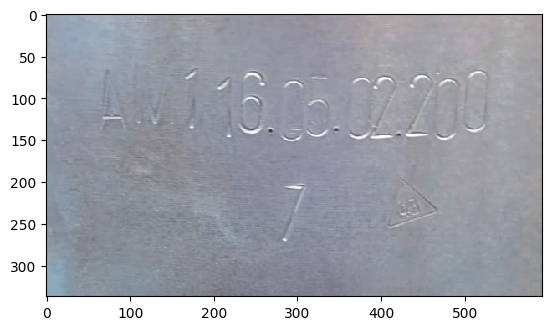

[2024/11/10 11:19:00] ppocr DEBUG: dt_boxes num : 1, elapsed : 0.05462241172790527
[2024/11/10 11:19:00] ppocr DEBUG: cls num  : 1, elapsed : 0.0041620731353759766
[2024/11/10 11:19:00] ppocr DEBUG: rec_res num  : 1, elapsed : 0.022840023040771484
RESULT [[[[[67.0, 56.0], [530.0, 64.0], [528.0, 157.0], [66.0, 149.0]], ('AM116.05.02.200', 0.8372754454612732)]]]
[     75.808       86.39       86.39       86.39       128.3       128.3      158.91      158.91      158.91      158.91]
140
РАСПОЗНАННЫЙ ТЕКСТ: AM116.05.02.200
МАРКИРОВКА: "АМ116.05.02.200 2"
0.292710542678833

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.5ms
Speed: 0.9ms preprocess, 6.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.43089      0.5275     0.40661     0.27869]]
COORD 218 609 497 854
CROP (357, 391, 3)


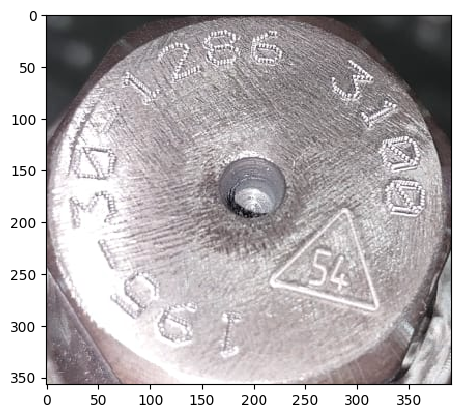

[2024/11/10 11:19:01] ppocr DEBUG: dt_boxes num : 3, elapsed : 0.03593301773071289
[2024/11/10 11:19:01] ppocr DEBUG: cls num  : 3, elapsed : 0.010430097579956055
[2024/11/10 11:19:01] ppocr DEBUG: rec_res num  : 3, elapsed : 0.06657075881958008
RESULT [None]

IMAGE SIZE; (3024, 4032)

0: 640x480 4 markings, 6.3ms
Speed: 1.6ms preprocess, 6.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.78603     0.39831     0.15553    0.040124]
 [     0.6526     0.33751     0.42811    0.056345]
 [    0.78134     0.39886       0.161    0.054466]
 [    0.66604     0.64015     0.19697    0.031401]]
COORD 2142 2612 1525 1687
CROP (162, 470, 3)


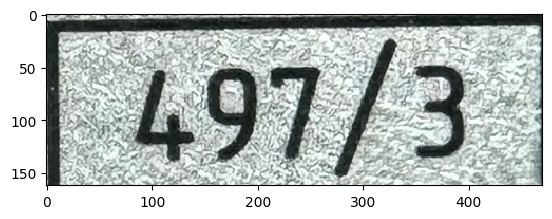

[2024/11/10 11:19:01] ppocr DEBUG: dt_boxes num : 1, elapsed : 0.03543543815612793
[2024/11/10 11:19:01] ppocr DEBUG: cls num  : 1, elapsed : 0.004264354705810547
[2024/11/10 11:19:01] ppocr DEBUG: rec_res num  : 1, elapsed : 0.023181438446044922
RESULT [[[[[75.0, 38.0], [401.0, 25.0], [405.0, 138.0], [79.0, 150.0]], ('497/3', 0.9986037015914917)]]]
[     229.55      229.55       251.8       251.8      275.74       300.9      405.98      407.58      425.15      425.15]
47
РАСПОЗНАННЫЙ ТЕКСТ: 497/3
МАРКИРОВКА: "АНЕМ.492664.500-03LP 497/1"
0.3321516513824463

IMAGE SIZE; (1530, 2040)

0: 640x480 2 markings, 6.3ms
Speed: 1.1ms preprocess, 6.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.50939     0.52086     0.86557     0.44653]
 [    0.88528     0.90224     0.22944     0.19553]]
COORD 117 1442 607 1518
CROP (911, 1325, 3)


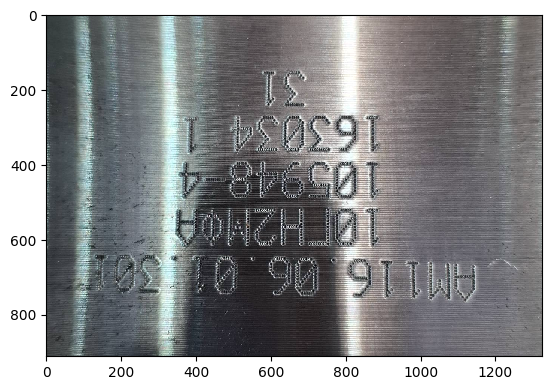

[2024/11/10 11:19:02] ppocr DEBUG: dt_boxes num : 5, elapsed : 0.11122369766235352
[2024/11/10 11:19:02] ppocr DEBUG: cls num  : 5, elapsed : 0.006256580352783203
[2024/11/10 11:19:02] ppocr DEBUG: rec_res num  : 5, elapsed : 0.13013887405395508
RESULT [[[[[356.0, 270.0], [894.0, 264.0], [895.0, 367.0], [357.0, 373.0]], ('163034-1', 0.9622129201889038)], [[[351.0, 392.0], [893.0, 392.0], [893.0, 491.0], [351.0, 491.0]], ('t-876501', 0.5895962119102478)], [[[344.0, 519.0], [896.0, 519.0], [896.0, 617.0], [344.0, 617.0]], ('HoAZH01', 0.5717248320579529)], [[[129.0, 628.0], [1155.0, 657.0], [1152.0, 768.0], [126.0, 739.0]], ('AM116.06.01301', 0.9931758046150208)]]]
[     243.26      243.26      243.26      259.51      259.51      265.06      265.06      265.06      265.06      265.06]
104
РАСПОЗНАННЫЙ ТЕКСТ: 163034-1 t-876501 HoAZH01 AM116.06.01301
МАРКИРОВКА: "АМ116.06.00.901-03 1"
0.7098736763000488

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 0.8ms preprocess, 6.3ms inf

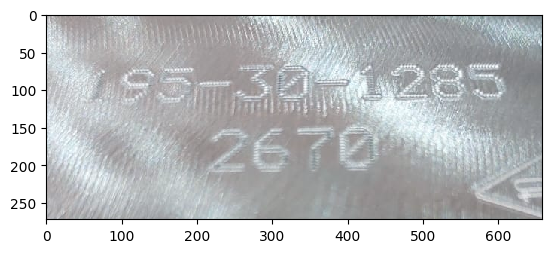

[2024/11/10 11:19:02] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.050885915756225586
[2024/11/10 11:19:02] ppocr DEBUG: cls num  : 2, elapsed : 0.010132789611816406
[2024/11/10 11:19:02] ppocr DEBUG: rec_res num  : 2, elapsed : 0.06502270698547363
RESULT [[[[[61.0, 71.0], [607.0, 62.0], [608.0, 120.0], [61.0, 129.0]], ('18503064285', 0.6649019122123718)], [[[217.0, 152.0], [444.0, 145.0], [446.0, 205.0], [219.0, 212.0]], ('2670', 0.9916189908981323)]]]
[     196.58      208.32      214.46      214.46      217.04      217.04      218.86      218.86      219.38       220.8]
222
РАСПОЗНАННЫЙ ТЕКСТ: 18503064285 2670
МАРКИРОВКА: "195-30-1285 2670"
0.3622164726257324

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.7ms
Speed: 0.9ms preprocess, 6.7ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.44397     0.48086     0.49507     0.35414]]
COORD 189 664 389 842
CROP (453, 475, 3)


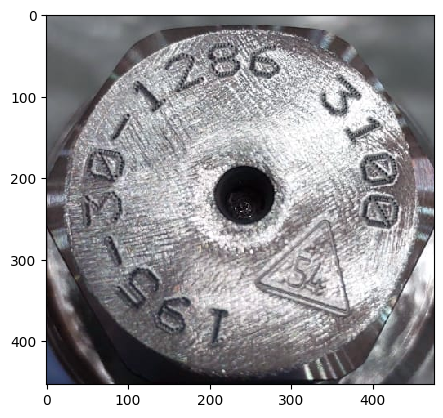

[2024/11/10 11:19:02] ppocr DEBUG: dt_boxes num : 7, elapsed : 0.05263781547546387
[2024/11/10 11:19:02] ppocr DEBUG: cls num  : 7, elapsed : 0.01544642448425293
[2024/11/10 11:19:03] ppocr DEBUG: rec_res num  : 7, elapsed : 0.13705706596374512
RESULT [[[[[317.0, 73.0], [400.0, 46.0], [466.0, 260.0], [383.0, 286.0]], ('3100', 0.9962501525878906)]]]
[     290.92      311.93      311.93         316      319.51      351.43      351.43      351.43       354.5      359.36]
39
РАСПОЗНАННЫЙ ТЕКСТ: 3100
МАРКИРОВКА: "195-30-1286 3101"
0.42277956008911133

IMAGE SIZE; (1600, 1200)

0: 480x640 2 markings, 6.1ms
Speed: 1.1ms preprocess, 6.1ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.84274     0.47546     0.31378     0.51786]
 [    0.49434     0.40431      0.3747     0.31438]]
COORD 1097 1599 260 881
CROP (621, 502, 3)


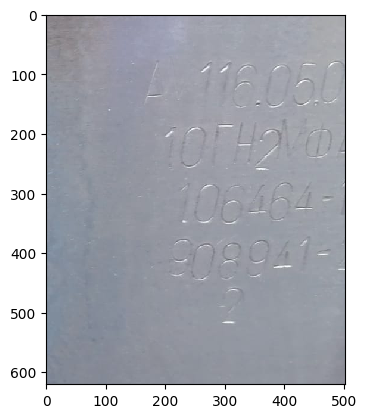

[2024/11/10 11:19:03] ppocr DEBUG: dt_boxes num : 4, elapsed : 0.06744718551635742
[2024/11/10 11:19:03] ppocr DEBUG: cls num  : 4, elapsed : 0.012336969375610352
[2024/11/10 11:19:03] ppocr DEBUG: rec_res num  : 4, elapsed : 0.08430314064025879
RESULT [[[[[243.0, 72.0], [492.0, 79.0], [490.0, 160.0], [241.0, 153.0]], ('116.05.0', 0.9156936407089233)], [[[196.0, 180.0], [487.0, 168.0], [491.0, 253.0], [199.0, 266.0]], ('10FH2V0', 0.6506527066230774)], [[[217.0, 278.0], [465.0, 273.0], [466.0, 353.0], [219.0, 358.0]], ('106464', 0.9866301417350769)], [[[210.0, 375.0], [480.0, 365.0], [482.0, 441.0], [212.0, 450.0]], ('908941-', 0.9605613946914673)]]]
[     295.41      295.41      295.41      295.41      295.41      295.41      297.97      299.11      299.62         304]
102
РАСПОЗНАННЫЙ ТЕКСТ: 116.05.0 10FH2V0 106464 908941-
МАРКИРОВКА: "АМ116.06.00.901-02"
0.629469633102417

IMAGE SIZE; (1530, 2040)

0: 640x480 1 marking, 6.6ms
Speed: 1.2ms preprocess, 6.6ms inference, 0.6ms postproces

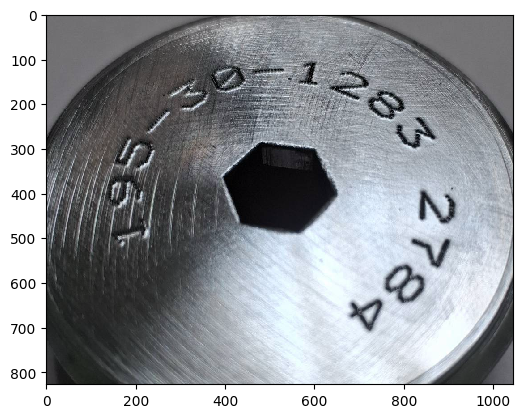

[2024/11/10 11:19:04] ppocr DEBUG: dt_boxes num : 1, elapsed : 0.11115741729736328
[2024/11/10 11:19:04] ppocr DEBUG: cls num  : 1, elapsed : 0.004772663116455078
[2024/11/10 11:19:04] ppocr DEBUG: rec_res num  : 1, elapsed : 0.02430415153503418
RESULT [None]

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 0.9ms preprocess, 6.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.45498     0.49257     0.59975      0.2305]]
COORD 149 725 483 778
CROP (295, 576, 3)


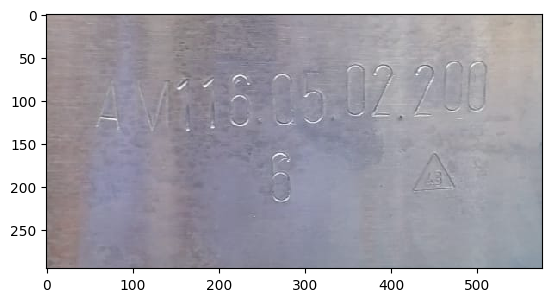

[2024/11/10 11:19:04] ppocr DEBUG: dt_boxes num : 1, elapsed : 0.05031728744506836
[2024/11/10 11:19:04] ppocr DEBUG: cls num  : 1, elapsed : 0.004858493804931641
[2024/11/10 11:19:04] ppocr DEBUG: rec_res num  : 1, elapsed : 0.03452277183532715
RESULT [[[[[73.0, 79.0], [504.0, 52.0], [508.0, 113.0], [77.0, 139.0]], ('1V/116.05.02200', 0.8570137023925781)]]]
[     177.66      177.66      177.66      226.56      255.07      255.07      258.01      272.88      272.88      276.62]
191
РАСПОЗНАННЫЙ ТЕКСТ: 1V/116.05.02200
МАРКИРОВКА: "АМ116.05.02.200 1"
0.30089712142944336

IMAGE SIZE; (960, 1280)

0: 640x480 2 markings, 6.5ms
Speed: 0.9ms preprocess, 6.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[     0.5251     0.42803     0.58708     0.29187]
 [    0.38914     0.94417     0.54835     0.11166]]
COORD 222 786 361 735
CROP (374, 564, 3)


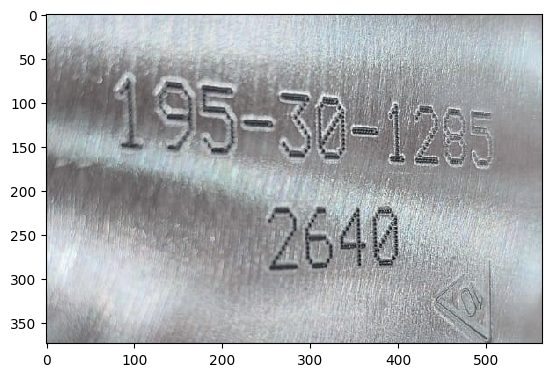

[2024/11/10 11:19:04] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.055126190185546875
[2024/11/10 11:19:04] ppocr DEBUG: cls num  : 2, elapsed : 0.010291576385498047
[2024/11/10 11:19:04] ppocr DEBUG: rec_res num  : 2, elapsed : 0.05045676231384277
RESULT [[[[[80.0, 63.0], [515.0, 104.0], [507.0, 188.0], [72.0, 148.0]], ('195-30-1285', 0.9930179119110107)], [[[244.0, 212.0], [409.0, 209.0], [411.0, 294.0], [246.0, 296.0]], ('2640', 0.9982483983039856)]]]
[          0      43.484      43.484      43.484      43.484      45.777      46.445      48.492      50.131      50.131]
59
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1285 2640
МАРКИРОВКА: "195-30-1285 2640"
0.36310291290283203

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 0.9ms preprocess, 6.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.46403     0.49995     0.44568     0.29689]]
COORD 232 659 450 830
CROP (380, 427, 3)


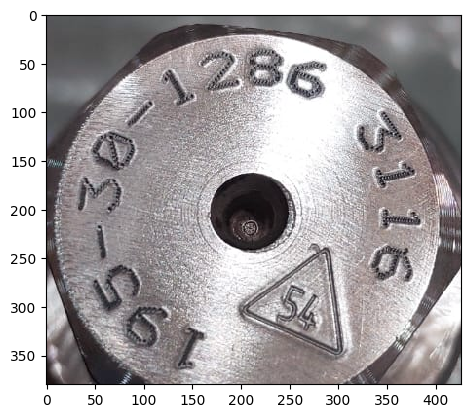

[2024/11/10 11:19:04] ppocr DEBUG: dt_boxes num : 4, elapsed : 0.045110225677490234
[2024/11/10 11:19:04] ppocr DEBUG: cls num  : 4, elapsed : 0.0061376094818115234
[2024/11/10 11:19:05] ppocr DEBUG: rec_res num  : 4, elapsed : 0.06998300552368164
RESULT [[[[[141.0, 26.0], [296.0, 30.0], [294.0, 97.0], [139.0, 94.0]], ('286', 0.9528687000274658)], [[[314.0, 97.0], [382.0, 92.0], [395.0, 281.0], [327.0, 285.0]], ('3116', 0.9502798914909363)]]]
[     152.48      251.46      251.46      255.13      256.87      266.33      266.33      267.23      267.23      271.83]
48
РАСПОЗНАННЫЙ ТЕКСТ: 286 3116
МАРКИРОВКА: "195-30-1286 3116"
0.34427642822265625

IMAGE SIZE; (1280, 1171)

0: 608x640 1 marking, 28.6ms
Speed: 1.4ms preprocess, 28.6ms inference, 0.5ms postprocess per image at shape (1, 3, 608, 640)
BBOX WH [[    0.48273     0.56563     0.73453     0.71802]]
COORD 148 1088 242 1083
CROP (841, 940, 3)


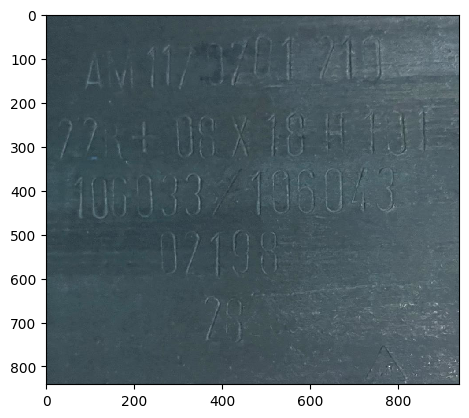

[2024/11/10 11:19:05] ppocr DEBUG: dt_boxes num : 5, elapsed : 0.12838220596313477
[2024/11/10 11:19:05] ppocr DEBUG: cls num  : 5, elapsed : 0.012681007385253906
[2024/11/10 11:19:05] ppocr DEBUG: rec_res num  : 5, elapsed : 0.12132477760314941
RESULT [[[[[85.0, 71.0], [772.0, 37.0], [778.0, 147.0], [91.0, 182.0]], ('AM 11/3701211', 0.857039213180542)], [[[23.0, 230.0], [888.0, 206.0], [891.0, 313.0], [26.0, 337.0]], ('72R+08X18H131', 0.7494325041770935)], [[[59.0, 366.0], [796.0, 346.0], [799.0, 447.0], [62.0, 467.0]], ('1060337195043', 0.8778025507926941)], [[[252.0, 497.0], [547.0, 492.0], [548.0, 590.0], [253.0, 595.0]], ('07198', 0.9122051000595093)]]]
[     348.49      358.54      361.61      373.43      380.58      380.58      380.58      385.92      385.92      385.92]
20
РАСПОЗНАННЫЙ ТЕКСТ: AM 11/3701211 72R+08X18H131 1060337195043 07198
МАРКИРОВКА: "АМ117.07.01.452 10"
0.6549458503723145

IMAGE SIZE; (1280, 520)

0: 288x640 2 markings, 28.6ms
Speed: 0.7ms preprocess, 28.6ms 

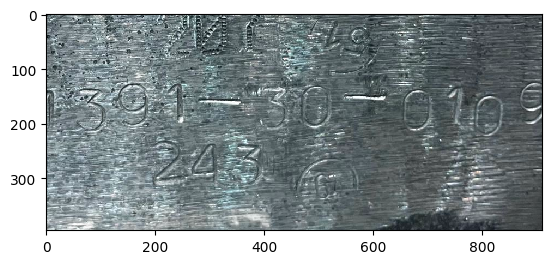

[2024/11/10 11:19:06] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.07706785202026367
[2024/11/10 11:19:06] ppocr DEBUG: cls num  : 2, elapsed : 0.004777193069458008
[2024/11/10 11:19:06] ppocr DEBUG: rec_res num  : 2, elapsed : 0.04003477096557617
RESULT [[[[[40.0, 115.0], [484.0, 109.0], [485.0, 202.0], [41.0, 208.0]], ('301-31', 0.7926256060600281)]]]
[     291.68      294.57      297.02      297.73      301.45      331.94      331.94      346.65      352.51      352.51]
45
РАСПОЗНАННЫЙ ТЕКСТ: 301-31
МАРКИРОВКА: "195-30-1285 3110"
0.37414026260375977

IMAGE SIZE; (1600, 886)

0: 384x640 1 marking, 29.6ms
Speed: 1.0ms preprocess, 29.6ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)
BBOX WH [[    0.52912     0.54128     0.72482     0.80885]]
COORD 267 1426 121 838
CROP (717, 1159, 3)


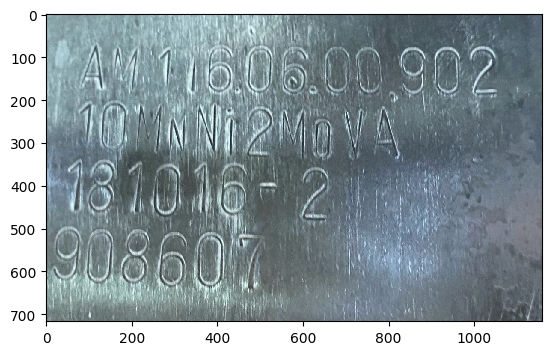

[2024/11/10 11:19:06] ppocr DEBUG: dt_boxes num : 4, elapsed : 0.10416746139526367
[2024/11/10 11:19:06] ppocr DEBUG: cls num  : 4, elapsed : 0.006277322769165039
[2024/11/10 11:19:06] ppocr DEBUG: rec_res num  : 4, elapsed : 0.09231400489807129
RESULT [[[[[92.0, 62.0], [1056.0, 75.0], [1054.0, 200.0], [90.0, 187.0]], ('A116.06.00902', 0.9107364416122437)], [[[70.0, 195.0], [834.0, 219.0], [830.0, 346.0], [66.0, 321.0]], ('10MNNI2M0VA', 0.7904481887817383)], [[[50.0, 335.0], [671.0, 355.0], [667.0, 482.0], [46.0, 462.0]], ('181016-2', 0.966128408908844)], [[[21.0, 490.0], [510.0, 511.0], [504.0, 648.0], [15.0, 627.0]], ('908607', 0.9918479919433594)]]]
[     212.44      219.37      219.37      219.37      219.37      219.37      219.37      234.35      237.68      237.68]
125
РАСПОЗНАННЫЙ ТЕКСТ: A116.06.00902 10MNNI2M0VA 181016-2 908607
МАРКИРОВКА: "АМ116.06.00.901-02 2"
0.6329643726348877

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 7.0ms
Speed: 0.9ms preprocess, 7.0ms inference, 0

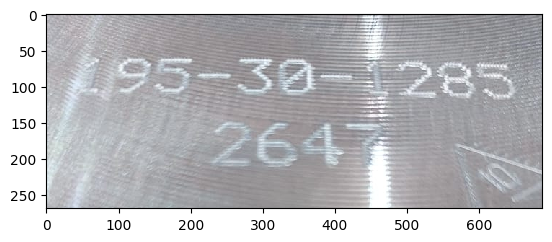

[2024/11/10 11:19:06] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.044571638107299805
[2024/11/10 11:19:06] ppocr DEBUG: cls num  : 2, elapsed : 0.004454851150512695
[2024/11/10 11:19:07] ppocr DEBUG: rec_res num  : 2, elapsed : 0.07009053230285645
RESULT [[[[[95.0, 52.0], [650.0, 63.0], [649.0, 121.0], [94.0, 110.0]], ('95-30-1285', 0.9488402605056763)], [[[230.0, 146.0], [417.0, 150.0], [416.0, 213.0], [229.0, 209.0]], ('264', 0.9961540699005127)]]]
[     124.36      124.36      130.59      131.42      131.42      131.42      133.69      133.71      133.71      133.71]
93
РАСПОЗНАННЫЙ ТЕКСТ: 95-30-1285 264
МАРКИРОВКА: "195-30-1285 2664"
0.34395694732666016

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 1.0ms preprocess, 6.3ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.41628     0.50161     0.41161     0.54385]]
COORD 202 597 294 990
CROP (696, 395, 3)


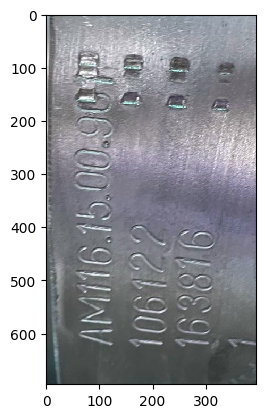

[2024/11/10 11:19:07] ppocr DEBUG: dt_boxes num : 3, elapsed : 0.05139613151550293
[2024/11/10 11:19:07] ppocr DEBUG: cls num  : 3, elapsed : 0.010929584503173828
[2024/11/10 11:19:07] ppocr DEBUG: rec_res num  : 3, elapsed : 0.06486749649047852
RESULT [[[[[46.0, 66.0], [131.0, 66.0], [133.0, 622.0], [48.0, 622.0]], ('AM116.15.00.90', 0.9458666443824768)], [[[148.0, 388.0], [228.0, 388.0], [228.0, 626.0], [148.0, 626.0]], ('106122', 0.9968379139900208)], [[[243.0, 399.0], [325.0, 404.0], [309.0, 628.0], [228.0, 622.0]], ('163816', 0.9959672093391418)]]]
[     259.42      259.42      259.42      259.42      259.42      259.42      259.42      260.32      260.32       263.4]
141
РАСПОЗНАННЫЙ ТЕКСТ: AM116.15.00.90 106122 163816
МАРКИРОВКА: "АМ116.06.00.962 1"
0.37074923515319824

IMAGE SIZE; (1280, 960)

0: 480x640 1 marking, 6.2ms
Speed: 0.9ms preprocess, 6.2ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.57304     0.56056     0.32148     0.63256]]
COO

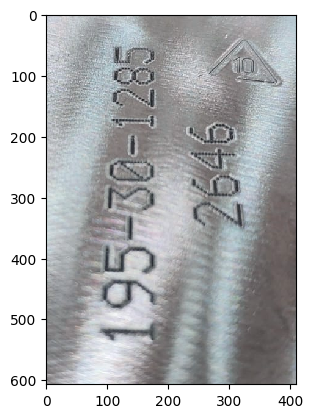

[2024/11/10 11:19:07] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.056168556213378906
[2024/11/10 11:19:07] ppocr DEBUG: cls num  : 2, elapsed : 0.005333423614501953
[2024/11/10 11:19:07] ppocr DEBUG: rec_res num  : 2, elapsed : 0.04053044319152832
RESULT [[[[[80.0, 32.0], [201.0, 35.0], [192.0, 543.0], [70.0, 541.0]], ('195-30-1285', 0.956360399723053)], [[[224.0, 168.0], [327.0, 164.0], [334.0, 352.0], [231.0, 355.0]], ('2646', 0.9953781366348267)]]]
[          0      28.284      28.284      28.284      40.132      40.907      42.353      42.353       44.68       44.68]
72
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1285 2646
МАРКИРОВКА: "195-30-1285 2646"
0.3424408435821533

IMAGE SIZE; (1600, 1200)

0: 480x640 1 marking, 6.3ms
Speed: 1.1ms preprocess, 6.3ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.48658     0.55494     0.73839     0.80665]]
COORD 188 1369 182 1150
CROP (968, 1181, 3)


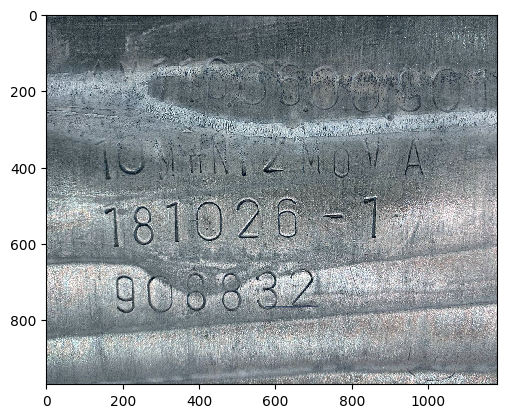

[2024/11/10 11:19:08] ppocr DEBUG: dt_boxes num : 3, elapsed : 0.13120579719543457
[2024/11/10 11:19:08] ppocr DEBUG: cls num  : 3, elapsed : 0.0058290958404541016
[2024/11/10 11:19:08] ppocr DEBUG: rec_res num  : 3, elapsed : 0.07568001747131348
RESULT [[[[[139.0, 312.0], [988.0, 312.0], [988.0, 427.0], [139.0, 427.0]], ('IONHNTZMOVA', 0.6392316818237305)], [[[151.0, 488.0], [879.0, 458.0], [885.0, 583.0], [156.0, 613.0]], ('181026-7', 0.9106818437576294)], [[[170.0, 670.0], [710.0, 661.0], [712.0, 775.0], [172.0, 783.0]], ('908832', 0.9069729447364807)]]]
[     366.12      373.82       377.9       377.9       377.9       377.9       377.9       377.9       377.9       377.9]
232
РАСПОЗНАННЫЙ ТЕКСТ: IONHNTZMOVA 181026-7 908832
МАРКИРОВКА: "195-30-0109 242"
0.6793942451477051

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.5ms
Speed: 0.9ms preprocess, 6.5ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.49036     0.32848     0.67083     0.20851]]
COO

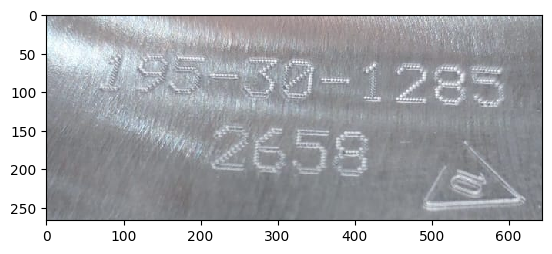

[2024/11/10 11:19:08] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.04982399940490723
[2024/11/10 11:19:08] ppocr DEBUG: cls num  : 2, elapsed : 0.004690408706665039
[2024/11/10 11:19:08] ppocr DEBUG: rec_res num  : 2, elapsed : 0.0609738826751709
RESULT [[[[[76.0, 42.0], [596.0, 68.0], [593.0, 124.0], [74.0, 98.0]], ('195-30-1285', 0.798856794834137)], [[[211.0, 138.0], [423.0, 148.0], [420.0, 215.0], [208.0, 205.0]], ('658', 0.8194365501403809)]]]
[     127.75      127.75      127.75      128.65      128.65      133.75      134.27      134.27      138.49      140.77]
183
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1285 658
МАРКИРОВКА: "195-30-1285 2668"
0.33172154426574707

IMAGE SIZE; (1280, 960)

0: 480x640 2 markings, 6.7ms
Speed: 1.6ms preprocess, 6.7ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.55409     0.31322     0.72118     0.62644]
 [    0.65786     0.31531     0.68427     0.63062]]
COORD 248 1171 0 601
CROP (601, 923, 3)


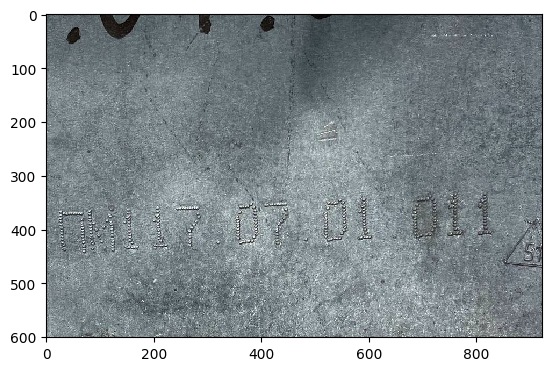

[2024/11/10 11:19:09] ppocr DEBUG: dt_boxes num : 1, elapsed : 0.10186195373535156
[2024/11/10 11:19:09] ppocr DEBUG: cls num  : 1, elapsed : 0.009235382080078125
[2024/11/10 11:19:09] ppocr DEBUG: rec_res num  : 1, elapsed : 0.04084491729736328
RESULT [[[[[17.0, 360.0], [834.0, 324.0], [838.0, 411.0], [21.0, 447.0]], ('P047607019011', 0.5349068641662598)]]]
[     388.63      388.63      397.35      404.13      408.81      409.96      411.51      411.51      417.01      417.01]
111
РАСПОЗНАННЫЙ ТЕКСТ: P047607019011
МАРКИРОВКА: "АМ116.06.00.901-04"
0.4679422378540039

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.5ms
Speed: 0.9ms preprocess, 6.5ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.44004     0.36951      0.6302     0.16947]]
COORD 120 725 365 581
CROP (216, 605, 3)


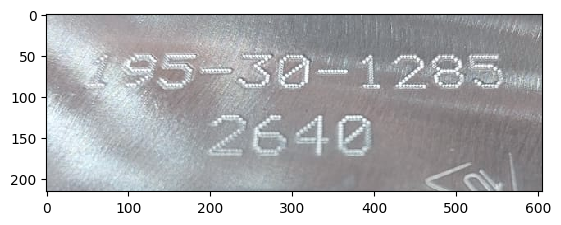

[2024/11/10 11:19:09] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.04703044891357422
[2024/11/10 11:19:09] ppocr DEBUG: cls num  : 2, elapsed : 0.005017757415771484
[2024/11/10 11:19:09] ppocr DEBUG: rec_res num  : 2, elapsed : 0.07201981544494629
RESULT [[[[[66.0, 47.0], [557.0, 45.0], [557.0, 91.0], [66.0, 93.0]], ('95301285', 0.7874884605407715)], [[[195.0, 120.0], [399.0, 120.0], [399.0, 177.0], [195.0, 177.0]], ('2640', 0.795566201210022)]]]
[     185.89      191.55      194.55      200.18      200.18      204.13      206.08      211.14      214.64      214.74]
59
РАСПОЗНАННЫЙ ТЕКСТ: 95301285 2640
МАРКИРОВКА: "195-30-1285 2640"
0.3251173496246338

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.5ms
Speed: 0.9ms preprocess, 6.5ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.46917     0.32657      0.7278     0.24644]]
COORD 101 800 260 576
CROP (316, 699, 3)


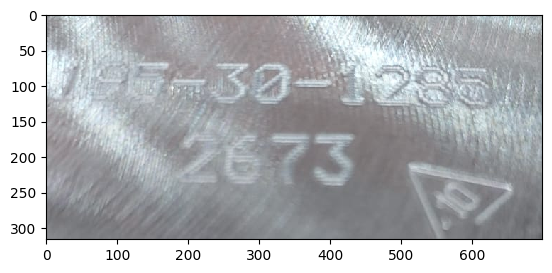

[2024/11/10 11:19:09] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.0575871467590332
[2024/11/10 11:19:09] ppocr DEBUG: cls num  : 2, elapsed : 0.0047452449798583984
[2024/11/10 11:19:09] ppocr DEBUG: rec_res num  : 2, elapsed : 0.0598759651184082
RESULT [[[[[63.0, 55.0], [631.0, 68.0], [629.0, 132.0], [61.0, 119.0]], ('95307200', 0.5268276929855347)], [[[190.0, 158.0], [438.0, 161.0], [437.0, 245.0], [188.0, 242.0]], ('2673', 0.9938279390335083)]]]
[     190.24      190.24      238.41      238.41      238.41      239.06      239.06      242.63      243.35      243.35]
227
РАСПОЗНАННЫЙ ТЕКСТ: 95307200 2673
МАРКИРОВКА: "195-30-1285 2673"
0.35164690017700195

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 0.9ms preprocess, 6.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.43826     0.35464     0.75256     0.20784]]
COORD 60 782 321 587
CROP (266, 722, 3)


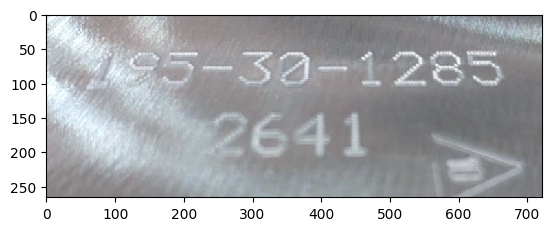

[2024/11/10 11:19:10] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.05497908592224121
[2024/11/10 11:19:10] ppocr DEBUG: cls num  : 2, elapsed : 0.004780292510986328
[2024/11/10 11:19:10] ppocr DEBUG: rec_res num  : 2, elapsed : 0.0698549747467041
RESULT [[[[[121.0, 54.0], [661.0, 52.0], [661.0, 102.0], [121.0, 104.0]], ('95-30-1085', 0.7559715509414673)], [[[242.0, 141.0], [464.0, 141.0], [464.0, 208.0], [242.0, 208.0]], ('2641', 0.9970194101333618)]]]
[      109.3      137.41      141.24       144.4      146.18      146.19      148.23      148.23      148.23      149.96]
60
РАСПОЗНАННЫЙ ТЕКСТ: 95-30-1085 2641
МАРКИРОВКА: "195-30-1285 2641"
0.3440234661102295

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 0.9ms preprocess, 6.3ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.48082     0.49726     0.52513     0.19617]]
COORD 210 714 511 762
CROP (251, 504, 3)


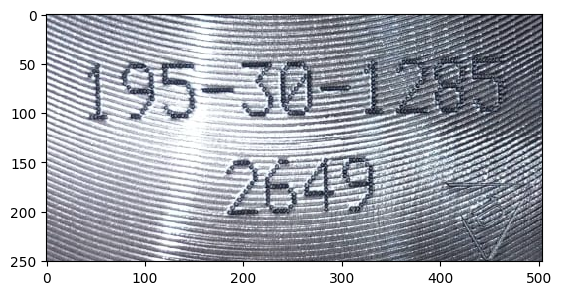

[2024/11/10 11:19:10] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.04325604438781738
[2024/11/10 11:19:10] ppocr DEBUG: cls num  : 2, elapsed : 0.004769325256347656
[2024/11/10 11:19:10] ppocr DEBUG: rec_res num  : 2, elapsed : 0.04941105842590332
RESULT [[[[[42.0, 47.0], [438.0, 39.0], [439.0, 100.0], [43.0, 108.0]], ('195-3012', 0.8846772909164429)], [[[174.0, 141.0], [337.0, 136.0], [339.0, 204.0], [176.0, 209.0]], ('2649', 0.9964248538017273)]]]
[     40.134      40.134      61.499      61.499      68.786      68.786      71.092       79.21      79.904      79.904]
76
РАСПОЗНАННЫЙ ТЕКСТ: 195-3012 2649
МАРКИРОВКА: "195-30-1285 2649"
0.3113265037536621

IMAGE SIZE; (1600, 1200)

0: 480x640 1 marking, 6.8ms
Speed: 1.1ms preprocess, 6.8ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.41222     0.50226     0.70908     0.79415]]
COORD 92 1227 126 1079
CROP (953, 1135, 3)


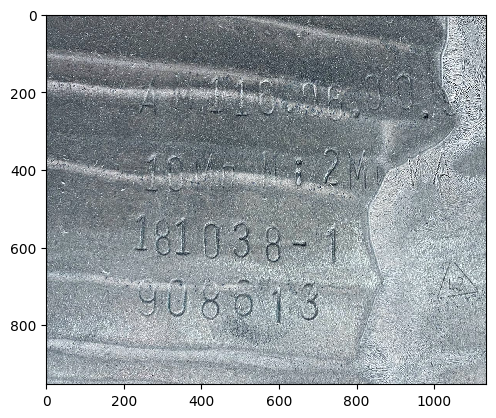

[2024/11/10 11:19:11] ppocr DEBUG: dt_boxes num : 4, elapsed : 0.13204264640808105
[2024/11/10 11:19:11] ppocr DEBUG: cls num  : 4, elapsed : 0.011667728424072266
[2024/11/10 11:19:11] ppocr DEBUG: rec_res num  : 4, elapsed : 0.08436393737792969
RESULT [[[[[459.0, 346.0], [827.0, 353.0], [825.0, 452.0], [457.0, 445.0]], ('2M', 0.686511218547821)], [[[228.0, 508.0], [760.0, 538.0], [754.0, 650.0], [221.0, 620.0]], ('181038-1', 0.9833717346191406)], [[[233.0, 672.0], [709.0, 687.0], [706.0, 799.0], [229.0, 784.0]], ('908013', 0.927461564540863)]]]
[     365.21      375.91       391.1       391.1      395.72      402.23      402.23         404      407.42      407.42]
184
РАСПОЗНАННЫЙ ТЕКСТ: 2M 181038-1 908013
МАРКИРОВКА: "АМ116.15.00.909 2"
0.6878132820129395

IMAGE SIZE; (4032, 3024)

0: 480x640 1 marking, 6.2ms
Speed: 1.4ms preprocess, 6.2ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.53651     0.50158     0.62559     0.63849]]
COORD 902 3424 551 24

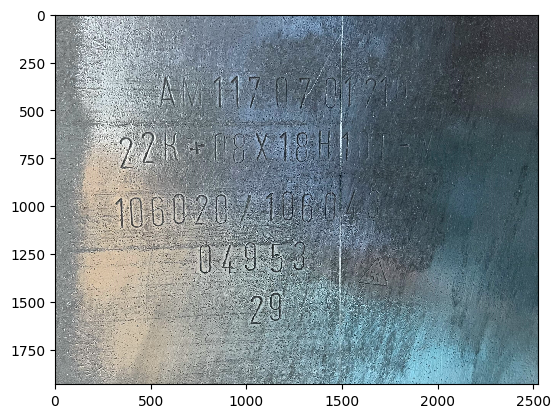

[2024/11/10 11:19:12] ppocr DEBUG: dt_boxes num : 6, elapsed : 0.12261462211608887
[2024/11/10 11:19:12] ppocr DEBUG: cls num  : 6, elapsed : 0.01231694221496582
[2024/11/10 11:19:12] ppocr DEBUG: rec_res num  : 6, elapsed : 0.11293458938598633
RESULT [[[[[486.0, 293.0], [1651.0, 316.0], [1647.0, 507.0], [482.0, 484.0]], ('AM117-0701', 0.8988701105117798)], [[[314.0, 605.0], [1467.0, 573.0], [1473.0, 772.0], [319.0, 804.0]], ('22K08X18H', 0.9294487833976746)], [[[308.0, 941.0], [1480.0, 903.0], [1486.0, 1085.0], [314.0, 1122.0]], ('106020/1060', 0.9728240966796875)], [[[727.0, 1173.0], [1333.0, 1167.0], [1335.0, 1361.0], [729.0, 1368.0]], ('04953', 0.9141367673873901)], [[[981.0, 1436.0], [1197.0, 1417.0], [1215.0, 1625.0], [999.0, 1644.0]], ('29', 0.9920809268951416)]]]
[     301.53      307.11      307.11      307.11      308.13      308.13      308.13      308.13      308.13      308.13]
134
РАСПОЗНАННЫЙ ТЕКСТ: AM117-0701 22K08X18H 106020/1060 04953 29
МАРКИРОВКА: "АМ116.06.00.901-0

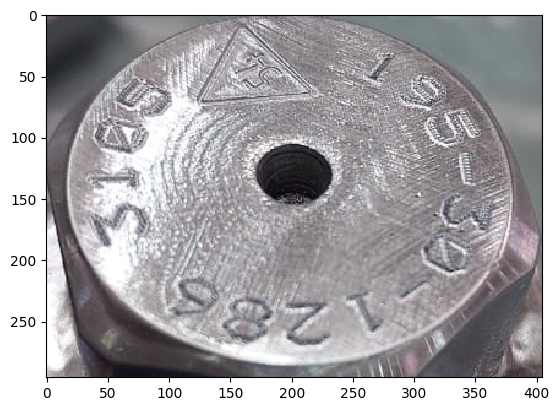

[2024/11/10 11:19:13] ppocr DEBUG: dt_boxes num : 5, elapsed : 0.04080796241760254
[2024/11/10 11:19:13] ppocr DEBUG: cls num  : 5, elapsed : 0.011452198028564453
[2024/11/10 11:19:13] ppocr DEBUG: rec_res num  : 5, elapsed : 0.09748148918151855
RESULT [[[[[29.0, 73.0], [87.0, 71.0], [91.0, 196.0], [33.0, 198.0]], ('OIS', 0.6171229481697083)]]]
[      561.9      566.56      567.42      570.01      572.83      572.83       573.1       573.1       573.1      573.26]
39
РАСПОЗНАННЫЙ ТЕКСТ: OIS
МАРКИРОВКА: "195-30-1286 3101"
0.35244226455688477

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 0.9ms preprocess, 6.3ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.57496     0.56192     0.50123     0.18687]]
COORD 311 793 600 839
CROP (239, 482, 3)


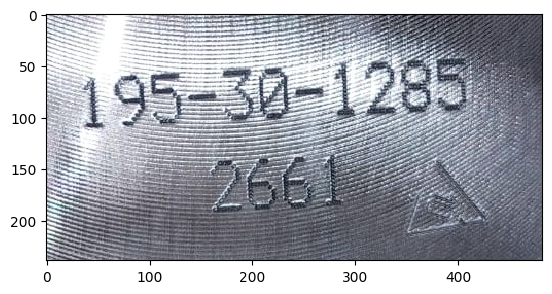

[2024/11/10 11:19:13] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.04027748107910156
[2024/11/10 11:19:13] ppocr DEBUG: cls num  : 2, elapsed : 0.00975179672241211
[2024/11/10 11:19:13] ppocr DEBUG: rec_res num  : 2, elapsed : 0.04851937294006348
RESULT [[[[[35.0, 56.0], [407.0, 38.0], [409.0, 93.0], [38.0, 112.0]], ('195-30-1285', 0.9651970267295837)], [[[152.0, 133.0], [292.0, 127.0], [294.0, 191.0], [154.0, 197.0]], ('2661', 0.9949560165405273)]]]
[          0      33.108      35.347      40.897      42.783      44.069      44.069      44.069      44.544      44.867]
41
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1285 2661
МАРКИРОВКА: "195-30-1285 2661"
0.3104081153869629

IMAGE SIZE; (1530, 2040)

0: 640x480 (no detections), 6.5ms
Speed: 1.1ms preprocess, 6.5ms inference, 0.2ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH []
CROP (2040, 1530, 3)


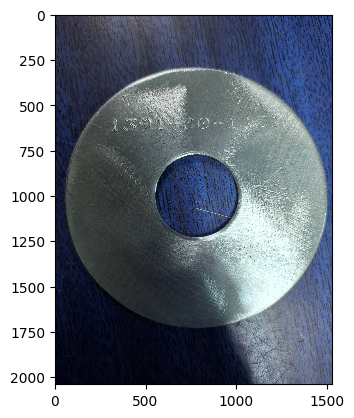

[2024/11/10 11:19:14] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.10923337936401367
[2024/11/10 11:19:14] ppocr DEBUG: cls num  : 2, elapsed : 0.004763603210449219
[2024/11/10 11:19:14] ppocr DEBUG: rec_res num  : 2, elapsed : 0.03876614570617676
RESULT [None]

IMAGE SIZE; (2856, 2142)

0: 480x640 1 marking, 6.0ms
Speed: 1.3ms preprocess, 6.0ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.55805     0.52231      0.2385     0.43611]]
COORD 1253 1934 652 1586
CROP (934, 681, 3)


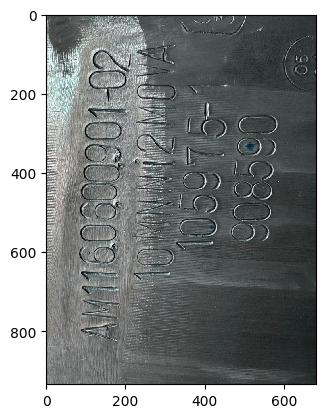

[2024/11/10 11:19:14] ppocr DEBUG: dt_boxes num : 5, elapsed : 0.10209369659423828
[2024/11/10 11:19:14] ppocr DEBUG: cls num  : 5, elapsed : 0.006399869918823242
[2024/11/10 11:19:14] ppocr DEBUG: rec_res num  : 5, elapsed : 0.08632493019104004
RESULT [[[[[90.0, 71.0], [230.0, 77.0], [194.0, 833.0], [54.0, 827.0]], ('4M1160600901-02', 0.9513046145439148)], [[[625.0, 102.0], [661.0, 102.0], [661.0, 125.0], [625.0, 125.0]], ('5', 0.6857501864433289)], [[[465.0, 273.0], [596.0, 281.0], [576.0, 588.0], [446.0, 579.0]], ('069806', 0.8945951461791992)]]]
[     276.72      284.22      284.22      290.66      290.66      290.66      290.66      292.23      292.23      300.73]
112
РАСПОЗНАННЫЙ ТЕКСТ: 4M1160600901-02 5 069806
МАРКИРОВКА: "АМ116.06.00.901-05 1"
0.5404932498931885

IMAGE SIZE; (4032, 3024)

0: 480x640 1 marking, 6.3ms
Speed: 1.4ms preprocess, 6.3ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.50993      0.3801     0.50486     0.68905]]
COORD 10

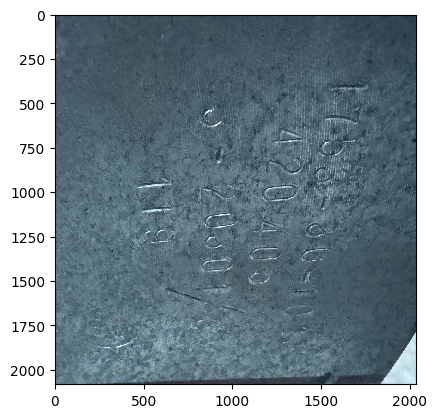

[2024/11/10 11:19:15] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.14765620231628418
[2024/11/10 11:19:15] ppocr DEBUG: cls num  : 2, elapsed : 0.004937648773193359
[2024/11/10 11:19:15] ppocr DEBUG: rec_res num  : 2, elapsed : 0.039395809173583984
RESULT [None]

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 7.1ms
Speed: 0.9ms preprocess, 7.1ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.51426     0.46729     0.49177     0.20856]]
COORD 258 730 465 732
CROP (267, 472, 3)


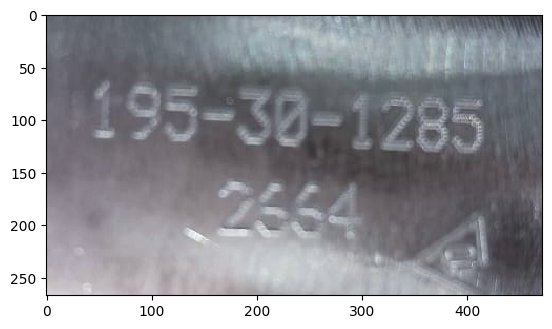

[2024/11/10 11:19:15] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.040986061096191406
[2024/11/10 11:19:15] ppocr DEBUG: cls num  : 2, elapsed : 0.0048182010650634766
[2024/11/10 11:19:16] ppocr DEBUG: rec_res num  : 2, elapsed : 0.05074930191040039
RESULT [[[[[48.0, 63.0], [416.0, 80.0], [413.0, 133.0], [46.0, 116.0]], ('195-30-1285', 0.9902418255805969)], [[[149.0, 152.0], [302.0, 158.0], [299.0, 220.0], [147.0, 213.0]], ('2554', 0.8423298597335815)]]]
[     43.874      43.874      72.752      72.752      83.738      83.738      83.738      84.132      85.134      85.134]
87
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1285 2554
МАРКИРОВКА: "195-30-1285 2654"
0.30335211753845215

IMAGE SIZE; (1280, 960)

0: 480x640 1 marking, 6.0ms
Speed: 0.9ms preprocess, 6.0ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.49765     0.47492     0.21134     0.36449]]
COORD 502 772 281 631
CROP (350, 270, 3)


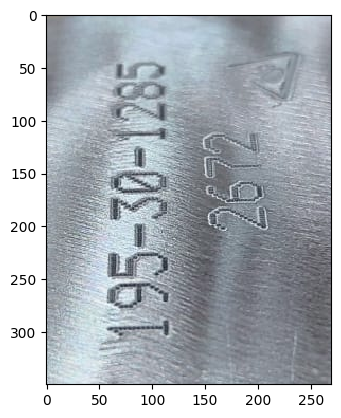

[2024/11/10 11:19:16] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.032239437103271484
[2024/11/10 11:19:16] ppocr DEBUG: cls num  : 2, elapsed : 0.004908561706542969
[2024/11/10 11:19:16] ppocr DEBUG: rec_res num  : 2, elapsed : 0.03914022445678711
RESULT [[[[[58.0, 40.0], [125.0, 42.0], [118.0, 318.0], [51.0, 316.0]], ('195-30-1285', 0.9928367733955383)], [[[152.0, 109.0], [210.0, 109.0], [210.0, 204.0], [152.0, 204.0]], ('2672', 0.9969234466552734)]]]
[          0           0      25.182      25.182       27.56       27.56       27.56       27.56      30.175      30.175]
225
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1285 2672
МАРКИРОВКА: "195-30-1285 2672"
0.28183436393737793

IMAGE SIZE; (1530, 2040)

0: 640x480 1 marking, 6.7ms
Speed: 1.1ms preprocess, 6.7ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.17563     0.57861     0.34886     0.44445]]
COORD 2 536 727 1634
CROP (907, 534, 3)


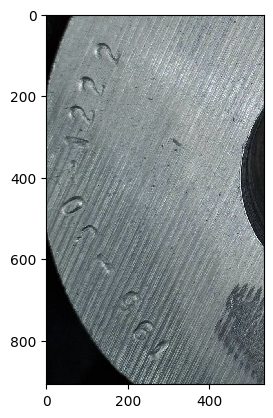

[2024/11/10 11:19:16] ppocr DEBUG: dt_boxes num : 1, elapsed : 0.08336210250854492
[2024/11/10 11:19:16] ppocr DEBUG: cls num  : 1, elapsed : 0.009654760360717773
[2024/11/10 11:19:16] ppocr DEBUG: rec_res num  : 1, elapsed : 0.032428741455078125
RESULT [None]

IMAGE SIZE; (1280, 960)

0: 480x640 2 markings, 6.1ms
Speed: 0.9ms preprocess, 6.1ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.53296     0.42575     0.22851      0.3863]
 [   0.073424     0.62344     0.14685     0.43116]]
COORD 536 828 223 594
CROP (371, 292, 3)


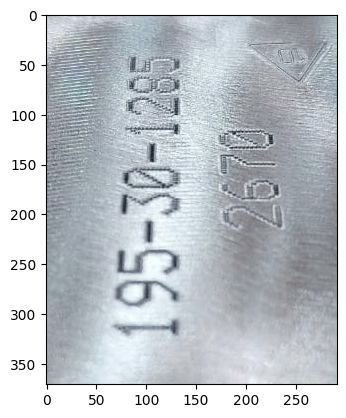

[2024/11/10 11:19:16] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.03548932075500488
[2024/11/10 11:19:16] ppocr DEBUG: cls num  : 2, elapsed : 0.004904747009277344
[2024/11/10 11:19:16] ppocr DEBUG: rec_res num  : 2, elapsed : 0.039403438568115234
RESULT [[[[[61.0, 36.0], [142.0, 36.0], [142.0, 333.0], [61.0, 333.0]], ('195-30-1285', 0.9854658246040344)], [[[162.0, 110.0], [235.0, 106.0], [242.0, 219.0], [169.0, 223.0]], ('2970', 0.714522123336792)]]]
[     67.032      92.011      92.011      95.354      96.249      96.963      96.963      99.723      99.889      101.98]
222
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1285 2970
МАРКИРОВКА: "195-30-1285 2670"
0.2880256175994873

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.8ms
Speed: 0.9ms preprocess, 6.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.59641     0.46095     0.68252     0.33576]]
COORD 245 900 375 805
CROP (430, 655, 3)


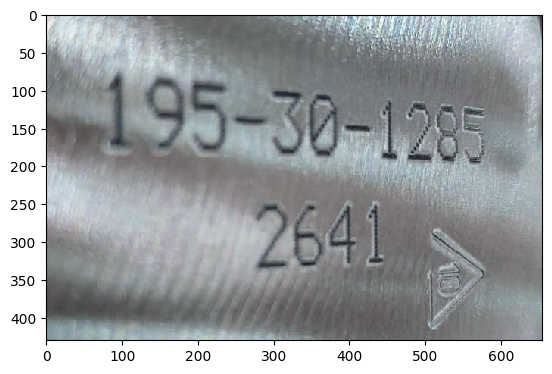

[2024/11/10 11:19:17] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.06224179267883301
[2024/11/10 11:19:17] ppocr DEBUG: cls num  : 2, elapsed : 0.0049593448638916016
[2024/11/10 11:19:17] ppocr DEBUG: rec_res num  : 2, elapsed : 0.04077625274658203
RESULT [[[[[77.0, 72.0], [590.0, 102.0], [584.0, 211.0], [71.0, 180.0]], ('195-30-1285', 0.993512749671936)], [[[269.0, 241.0], [455.0, 241.0], [455.0, 343.0], [269.0, 343.0]], ('2641', 0.9974514245986938)]]]
[          0      31.927      40.897      42.119      45.538      45.538      45.538      45.538      48.492      51.521]
60
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1285 2641
МАРКИРОВКА: "195-30-1285 2641"
0.368438720703125

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.7ms
Speed: 1.0ms preprocess, 6.7ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.48026      0.3443      0.6188     0.19251]]
COORD 164 758 318 564
CROP (246, 594, 3)


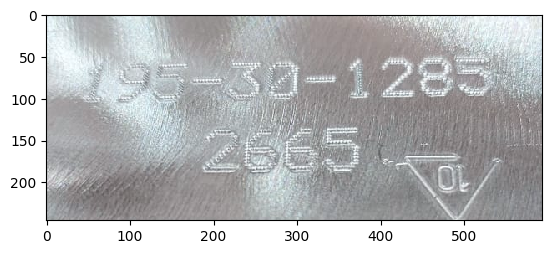

[2024/11/10 11:19:17] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.049360036849975586
[2024/11/10 11:19:17] ppocr DEBUG: cls num  : 2, elapsed : 0.005133628845214844
[2024/11/10 11:19:17] ppocr DEBUG: rec_res num  : 2, elapsed : 0.06284308433532715
RESULT [[[[[64.0, 57.0], [528.0, 48.0], [529.0, 97.0], [65.0, 106.0]], ('95-3-1285', 0.8288024067878723)], [[[184.0, 130.0], [384.0, 130.0], [384.0, 194.0], [184.0, 194.0]], ('665', 0.7748920321464539)]]]
[     220.43      220.43      220.43      222.73      231.73      239.42      239.42      239.42      240.46      240.46]
157
РАСПОЗНАННЫЙ ТЕКСТ: 95-3-1285 665
МАРКИРОВКА: "195-30-1285 2667"
0.3296689987182617

IMAGE SIZE; (4000, 3000)

0: 480x640 (no detections), 6.1ms
Speed: 1.4ms preprocess, 6.1ms inference, 0.2ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH []
CROP (3000, 4000, 3)


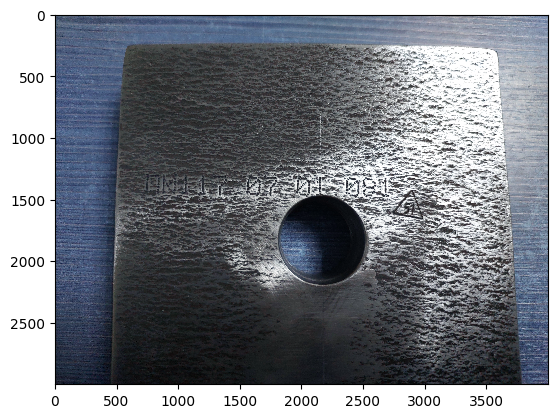

[2024/11/10 11:19:20] ppocr DEBUG: dt_boxes num : 1, elapsed : 0.11164307594299316
[2024/11/10 11:19:20] ppocr DEBUG: cls num  : 1, elapsed : 0.0049631595611572266
[2024/11/10 11:19:20] ppocr DEBUG: rec_res num  : 1, elapsed : 0.04587531089782715
RESULT [None]

IMAGE SIZE; (1280, 960)

0: 480x640 1 marking, 5.8ms
Speed: 0.9ms preprocess, 5.8ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.59339      0.4801     0.22292     0.44807]]
COORD 617 902 246 676
CROP (430, 285, 3)


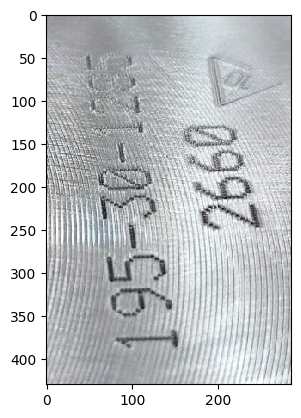

[2024/11/10 11:19:20] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.03698229789733887
[2024/11/10 11:19:20] ppocr DEBUG: cls num  : 2, elapsed : 0.005059480667114258
[2024/11/10 11:19:20] ppocr DEBUG: rec_res num  : 2, elapsed : 0.0399470329284668
RESULT [[[[[24.0, 39.0], [115.0, 26.0], [162.0, 388.0], [71.0, 401.0]], ('195-30-1205', 0.8991777896881104)]]]
[     113.51      131.89      140.15      140.15      140.29      140.29      143.35      143.35      145.41      149.83]
40
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1205
МАРКИРОВКА: "195-30-1286 3105"
0.2756373882293701

IMAGE SIZE; (1280, 960)

0: 480x640 1 marking, 5.7ms
Speed: 0.8ms preprocess, 5.7ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.56059     0.53529     0.74013      0.8437]]
COORD 244 1191 109 919
CROP (810, 947, 3)


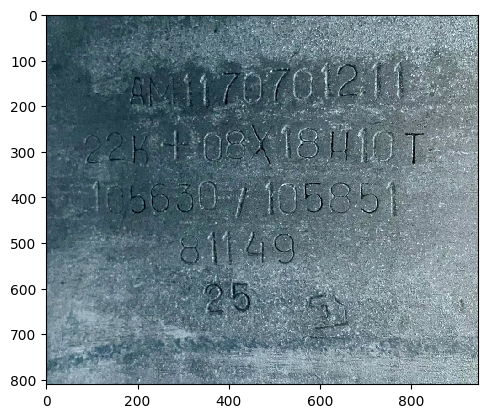

[2024/11/10 11:19:21] ppocr DEBUG: dt_boxes num : 6, elapsed : 0.12513113021850586
[2024/11/10 11:19:21] ppocr DEBUG: cls num  : 6, elapsed : 0.012742280960083008
[2024/11/10 11:19:21] ppocr DEBUG: rec_res num  : 6, elapsed : 0.21200227737426758
RESULT [[[[[185.0, 118.0], [796.0, 86.0], [800.0, 183.0], [190.0, 215.0]], ('AM1170701211', 0.9250597357749939)], [[[74.0, 237.0], [829.0, 233.0], [830.0, 332.0], [74.0, 336.0]], ('22K108X1810T', 0.8790526390075684)], [[[81.0, 360.0], [781.0, 363.0], [781.0, 442.0], [81.0, 439.0]], ('1056307105851', 0.9674282670021057)], [[[286.0, 474.0], [548.0, 474.0], [548.0, 552.0], [286.0, 552.0]], ('81149', 0.9836946725845337)], [[[339.0, 570.0], [459.0, 582.0], [451.0, 662.0], [331.0, 650.0]], ('25', 0.6569942235946655)]]]
[     316.38      328.07      329.57      334.05      334.05      334.05      360.16      368.04      372.93      373.28]
251
РАСПОЗНАННЫЙ ТЕКСТ: AM1170701211 22K108X1810T 1056307105851 81149 25
МАРКИРОВКА: "АМ117.07.01.211 25"
0.75618

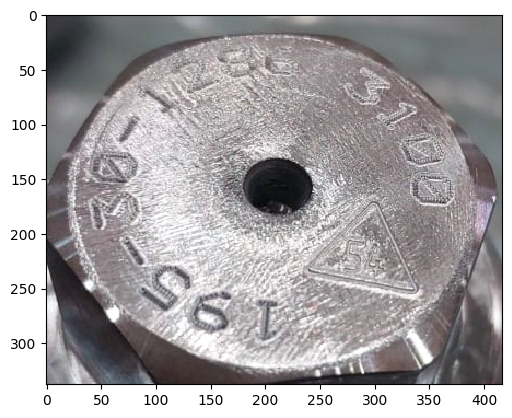

[2024/11/10 11:19:21] ppocr DEBUG: dt_boxes num : 6, elapsed : 0.04389643669128418
[2024/11/10 11:19:21] ppocr DEBUG: cls num  : 6, elapsed : 0.006690502166748047
[2024/11/10 11:19:22] ppocr DEBUG: rec_res num  : 6, elapsed : 0.11280107498168945
RESULT [[[[[318.0, 98.0], [364.0, 92.0], [376.0, 175.0], [329.0, 181.0]], ('00', 0.9423712491989136)], [[[97.0, 202.0], [196.0, 252.0], [165.0, 308.0], [66.0, 258.0]], ('96', 0.7774944305419922)]]]
[     383.31      383.31      383.31      383.31      383.31      383.31      383.31      390.44      390.44      391.12]
141
РАСПОЗНАННЫЙ ТЕКСТ: 00 96
МАРКИРОВКА: "АМ116.06.00.962 1"
0.3759584426879883

IMAGE SIZE; (2856, 2142)

0: 480x640 1 marking, 6.0ms
Speed: 1.2ms preprocess, 6.0ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.55805     0.52231      0.2385     0.43611]]
COORD 1253 1934 652 1586
CROP (934, 681, 3)


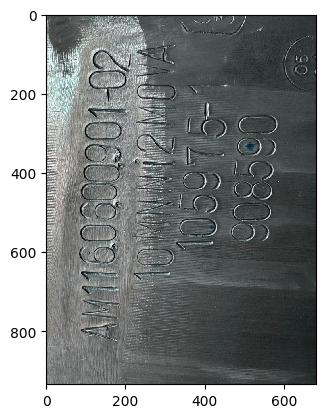

[2024/11/10 11:19:22] ppocr DEBUG: dt_boxes num : 5, elapsed : 0.10587167739868164
[2024/11/10 11:19:22] ppocr DEBUG: cls num  : 5, elapsed : 0.01177072525024414
[2024/11/10 11:19:22] ppocr DEBUG: rec_res num  : 5, elapsed : 0.0981752872467041
RESULT [[[[[90.0, 71.0], [230.0, 77.0], [194.0, 833.0], [54.0, 827.0]], ('4M1160600901-02', 0.9513046145439148)], [[[625.0, 102.0], [661.0, 102.0], [661.0, 125.0], [625.0, 125.0]], ('5', 0.6857501864433289)], [[[465.0, 273.0], [596.0, 281.0], [576.0, 588.0], [446.0, 579.0]], ('069806', 0.8945951461791992)]]]
[     276.72      284.22      284.22      290.66      290.66      290.66      290.66      292.23      292.23      300.73]
112
РАСПОЗНАННЫЙ ТЕКСТ: 4M1160600901-02 5 069806
МАРКИРОВКА: "АМ116.06.00.901-05 1"
0.5722801685333252

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.7ms
Speed: 0.9ms preprocess, 6.7ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.42937     0.54127     0.42157      0.2602]]
COORD 210 6

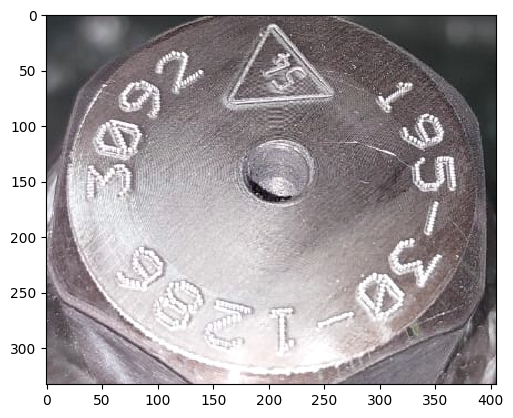

[2024/11/10 11:19:22] ppocr DEBUG: dt_boxes num : 4, elapsed : 0.04255938529968262
[2024/11/10 11:19:22] ppocr DEBUG: cls num  : 4, elapsed : 0.01101994514465332
[2024/11/10 11:19:22] ppocr DEBUG: rec_res num  : 4, elapsed : 0.08488154411315918
RESULT [[[[[199.0, 263.0], [226.0, 263.0], [226.0, 303.0], [199.0, 303.0]], ('T.', 0.5703161954879761)]]]
[     499.78      499.99      499.99      502.31      503.34      503.34      503.52      503.52      505.52      506.55]
48
РАСПОЗНАННЫЙ ТЕКСТ: T.
МАРКИРОВКА: "195-30-1286 3116"
0.3466026782989502

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.7ms
Speed: 1.0ms preprocess, 6.7ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.50526     0.34985     0.85922     0.69969]]
COORD 73 897 0 896
CROP (896, 824, 3)


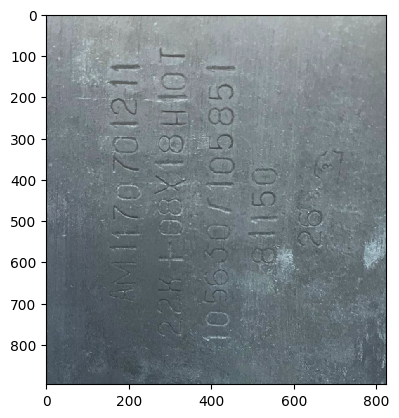

[2024/11/10 11:19:23] ppocr DEBUG: dt_boxes num : 6, elapsed : 0.11885309219360352
[2024/11/10 11:19:23] ppocr DEBUG: cls num  : 6, elapsed : 0.007266521453857422
[2024/11/10 11:19:23] ppocr DEBUG: rec_res num  : 6, elapsed : 0.12276077270507812
RESULT [[[[[256.0, 71.0], [354.0, 73.0], [342.0, 777.0], [244.0, 775.0]], ('2K+08X18HI0T', 0.8367474675178528)], [[[140.0, 97.0], [235.0, 96.0], [243.0, 654.0], [148.0, 655.0]], ('M1170701211', 0.9884685277938843)], [[[380.0, 107.0], [475.0, 110.0], [459.0, 808.0], [364.0, 805.0]], ('1056307105851', 0.9609411954879761)], [[[491.0, 342.0], [565.0, 342.0], [565.0, 592.0], [491.0, 592.0]], ('31150.', 0.9120757579803467)], [[[611.0, 463.0], [673.0, 463.0], [673.0, 564.0], [611.0, 564.0]], ('92', 0.7233320474624634)]]]
[     334.27      346.63      346.63      351.86      351.86      351.86      358.82      358.82      360.16      361.02]
4
РАСПОЗНАННЫЙ ТЕКСТ: 2K+08X18HI0T M1170701211 1056307105851 31150. 92
МАРКИРОВКА: "АМ117.07.01.210 32"
0.626635

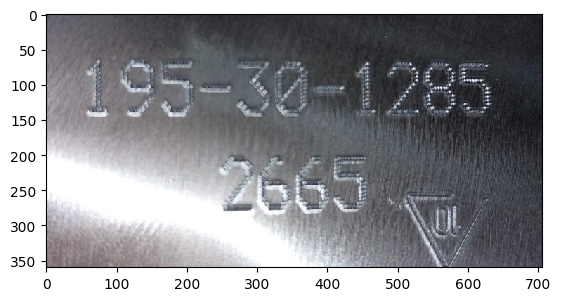

[2024/11/10 11:19:23] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.061992645263671875
[2024/11/10 11:19:23] ppocr DEBUG: cls num  : 2, elapsed : 0.010214090347290039
[2024/11/10 11:19:23] ppocr DEBUG: rec_res num  : 2, elapsed : 0.052980661392211914
RESULT [[[[[59.0, 65.0], [634.0, 65.0], [634.0, 146.0], [59.0, 146.0]], ('195-30-1285', 0.9731571674346924)], [[[246.0, 195.0], [460.0, 195.0], [460.0, 288.0], [246.0, 288.0]], ('2665', 0.9884287118911743)]]]
[          0      18.228      18.228      36.046      36.471      36.471      36.471      36.882      36.882      36.882]
119
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1285 2665
МАРКИРОВКА: "195-30-1285 2665"
0.3622908592224121

IMAGE SIZE; (4000, 3000)

0: 480x640 1 marking, 6.0ms
Speed: 1.3ms preprocess, 6.0ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.16969     0.48721     0.33939     0.43006]]
COORD 0 1358 817 2107
CROP (1290, 1358, 3)


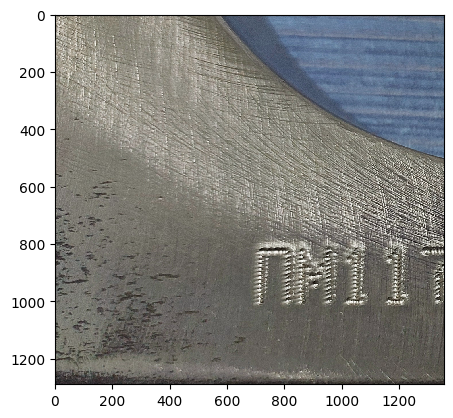

[2024/11/10 11:19:24] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.13855695724487305
[2024/11/10 11:19:24] ppocr DEBUG: cls num  : 2, elapsed : 0.005512714385986328
[2024/11/10 11:19:24] ppocr DEBUG: rec_res num  : 2, elapsed : 0.04889678955078125
RESULT [[[[[669.0, 769.0], [1279.0, 769.0], [1279.0, 1039.0], [669.0, 1039.0]], ('n11', 0.6925371289253235)], [[[1282.0, 816.0], [1338.0, 816.0], [1338.0, 842.0], [1282.0, 842.0]], ('NEER', 0.5524964332580566)]]]
[     400.71       464.5      471.24       512.5       512.5      518.75      518.75      518.75      520.77      520.77]
18
РАСПОЗНАННЫЙ ТЕКСТ: n11 NEER
МАРКИРОВКА: "АМ117.07.01.300 11"
0.8222134113311768

IMAGE SIZE; (1280, 960)

0: 480x640 1 marking, 6.0ms
Speed: 0.9ms preprocess, 6.0ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.60874      0.5743     0.65161     0.68432]]
COORD 362 1196 223 880
CROP (657, 834, 3)


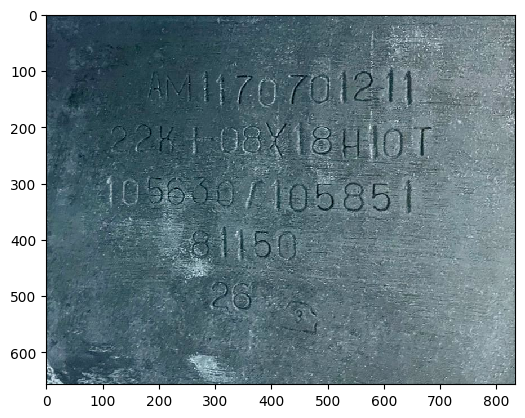

[2024/11/10 11:19:25] ppocr DEBUG: dt_boxes num : 5, elapsed : 0.09906435012817383
[2024/11/10 11:19:25] ppocr DEBUG: cls num  : 5, elapsed : 0.01204538345336914
[2024/11/10 11:19:25] ppocr DEBUG: rec_res num  : 5, elapsed : 0.12520527839660645
RESULT [[[[[180.0, 100.0], [656.0, 94.0], [657.0, 160.0], [181.0, 166.0]], ('AM1170701211', 0.9933943748474121)], [[[105.0, 184.0], [682.0, 190.0], [681.0, 257.0], [104.0, 251.0]], ('22x08X1810T', 0.7885661721229553)], [[[109.0, 283.0], [653.0, 294.0], [652.0, 354.0], [108.0, 344.0]], ('105630/105851', 0.9481427669525146)], [[[229.0, 376.0], [456.0, 382.0], [454.0, 440.0], [227.0, 435.0]], ('81150', 0.9695082902908325)], [[[290.0, 477.0], [386.0, 477.0], [386.0, 524.0], [290.0, 524.0]], ('26', 0.952505886554718)]]]
[     298.67      324.34      334.75      339.27      352.74      353.24      353.24      354.17      357.41      359.33]
20
РАСПОЗНАННЫЙ ТЕКСТ: AM1170701211 22x08X1810T 105630/105851 81150 26
МАРКИРОВКА: "АМ117.07.01.452 10"
0.603093

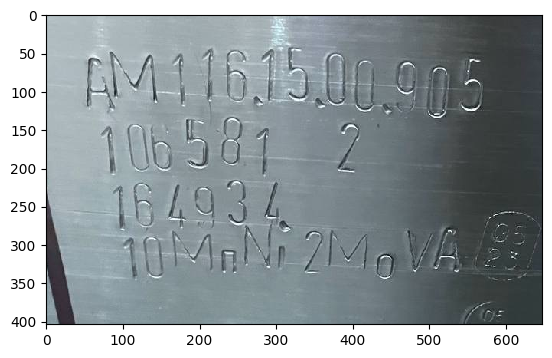

[2024/11/10 11:19:25] ppocr DEBUG: dt_boxes num : 6, elapsed : 0.06190657615661621
[2024/11/10 11:19:25] ppocr DEBUG: cls num  : 6, elapsed : 0.01204371452331543
[2024/11/10 11:19:25] ppocr DEBUG: rec_res num  : 6, elapsed : 0.1326436996459961
RESULT [[[[[50.0, 34.0], [572.0, 47.0], [569.0, 138.0], [48.0, 125.0]], ('AM11615.00.905', 0.9361730217933655)], [[[70.0, 134.0], [414.0, 132.0], [414.0, 207.0], [70.0, 209.0]], ('1065812', 0.9872325658798218)], [[[86.0, 222.0], [311.0, 214.0], [314.0, 272.0], [89.0, 280.0]], ('164934', 0.9903072714805603)], [[[95.0, 277.0], [553.0, 270.0], [554.0, 340.0], [96.0, 347.0]], ('10MNi2MVA', 0.9288644790649414)], [[[526.0, 285.0], [615.0, 269.0], [625.0, 323.0], [536.0, 339.0]], ('12', 0.5002620220184326)]]]
[      317.2      328.21      351.95      364.37      364.37      364.37      364.37      364.37      364.37      364.37]
184
РАСПОЗНАННЫЙ ТЕКСТ: AM11615.00.905 1065812 164934 10MNi2MVA 12
МАРКИРОВКА: "АМ116.15.00.909 2"
0.48698949813842773

IMAGE 

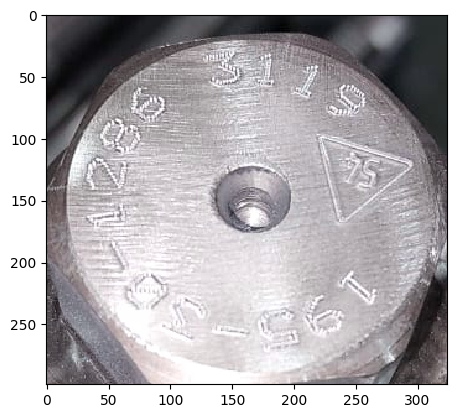

[2024/11/10 11:19:26] ppocr DEBUG: dt_boxes num : 3, elapsed : 0.033643484115600586
[2024/11/10 11:19:26] ppocr DEBUG: cls num  : 3, elapsed : 0.010174036026000977
[2024/11/10 11:19:26] ppocr DEBUG: rec_res num  : 3, elapsed : 0.06648588180541992
RESULT [None]

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.6ms
Speed: 0.9ms preprocess, 6.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.47285     0.34179     0.70544     0.22429]]
COORD 115 793 294 581
CROP (287, 678, 3)


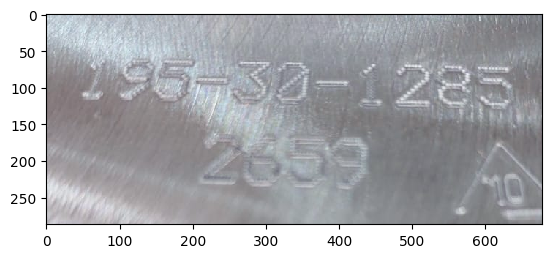

[2024/11/10 11:19:26] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.0544743537902832
[2024/11/10 11:19:26] ppocr DEBUG: cls num  : 2, elapsed : 0.009844064712524414
[2024/11/10 11:19:26] ppocr DEBUG: rec_res num  : 2, elapsed : 0.06630253791809082
RESULT [[[[[52.0, 58.0], [635.0, 69.0], [634.0, 130.0], [51.0, 119.0]], ('195430-1283', 0.7968193292617798)], [[[214.0, 154.0], [444.0, 161.0], [441.0, 244.0], [211.0, 236.0]], ('2059', 0.845911979675293)]]]
[     304.97      304.97      304.97      309.87      319.12      319.99      320.02      323.72      324.18      324.18]
28
РАСПОЗНАННЫЙ ТЕКСТ: 195430-1283 2059
МАРКИРОВКА: "195-30-1286 3089"
0.35210752487182617

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.5ms
Speed: 0.9ms preprocess, 6.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.57072     0.32473     0.72992      0.2104]]
COORD 198 898 281 550
CROP (269, 700, 3)


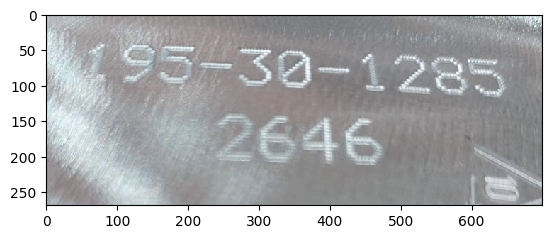

[2024/11/10 11:19:26] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.04608559608459473
[2024/11/10 11:19:26] ppocr DEBUG: cls num  : 2, elapsed : 0.004746437072753906
[2024/11/10 11:19:26] ppocr DEBUG: rec_res num  : 2, elapsed : 0.06744098663330078
RESULT [[[[[61.0, 36.0], [644.0, 58.0], [642.0, 116.0], [59.0, 94.0]], ('195-30-1285', 0.9353079199790955)], [[[239.0, 134.0], [474.0, 139.0], [472.0, 215.0], [237.0, 210.0]], ('2646', 0.9865254163742065)]]]
[          0      28.284      28.284      28.284      40.132      40.907      42.353      42.353       44.68       44.68]
72
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1285 2646
МАРКИРОВКА: "195-30-1285 2646"
0.3361091613769531

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 0.9ms preprocess, 6.3ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.49734     0.52961     0.59327     0.61315]]
COORD 193 762 285 1070
CROP (785, 569, 3)


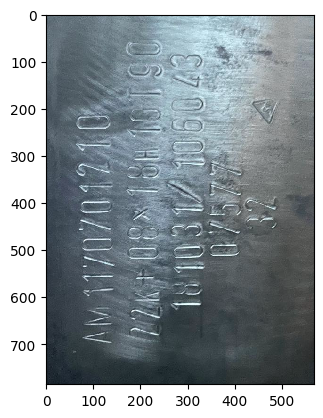

[2024/11/10 11:19:27] ppocr DEBUG: dt_boxes num : 5, elapsed : 0.08261370658874512
[2024/11/10 11:19:27] ppocr DEBUG: cls num  : 5, elapsed : 0.012516975402832031
[2024/11/10 11:19:27] ppocr DEBUG: rec_res num  : 5, elapsed : 0.09833288192749023
RESULT [[[[[163.0, 51.0], [258.0, 52.0], [253.0, 695.0], [158.0, 694.0]], ('22K08x1810190', 0.7863575220108032)], [[[255.0, 65.0], [350.0, 65.0], [346.0, 642.0], [251.0, 641.0]], ('181031/106043', 0.9876658916473389)], [[[53.0, 192.0], [142.0, 190.0], [153.0, 703.0], [64.0, 705.0]], ('AM11/0701210', 0.9541786313056946)], [[[345.0, 278.0], [422.0, 281.0], [411.0, 529.0], [334.0, 526.0]], ('0/577', 0.9557062983512878)]]]
[     332.97      354.34      355.68      363.22       376.4       376.4       376.4      377.17      378.99      387.08]
20
РАСПОЗНАННЫЙ ТЕКСТ: 22K08x1810190 181031/106043 AM11/0701210 0/577
МАРКИРОВКА: "АМ117.07.01.452 10"
0.513850212097168

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.7ms
Speed: 0.9ms preprocess, 6.7ms inf

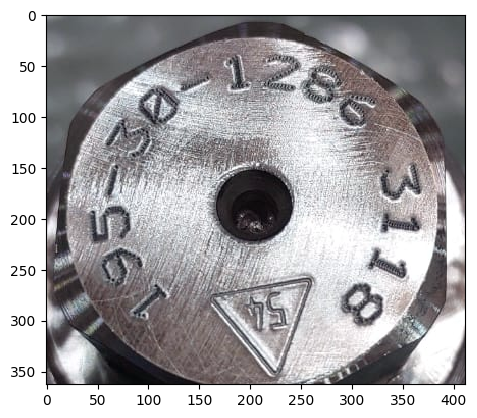

[2024/11/10 11:19:27] ppocr DEBUG: dt_boxes num : 5, elapsed : 0.043702125549316406
[2024/11/10 11:19:27] ppocr DEBUG: cls num  : 5, elapsed : 0.006174564361572266
[2024/11/10 11:19:27] ppocr DEBUG: rec_res num  : 5, elapsed : 0.09263134002685547
RESULT [[[[[168.0, 37.0], [202.0, 34.0], [205.0, 78.0], [172.0, 81.0]], ('1', 0.9972487092018127)], [[[211.0, 36.0], [258.0, 36.0], [258.0, 82.0], [211.0, 82.0]], ('2', 0.8013397455215454)], [[[262.0, 30.0], [338.0, 91.0], [305.0, 136.0], [229.0, 75.0]], ('86', 0.63410484790802)], [[[329.0, 124.0], [394.0, 145.0], [339.0, 328.0], [274.0, 307.0]], ('3118', 0.9899957180023193)], [[[196.0, 273.0], [240.0, 276.0], [237.0, 316.0], [193.0, 313.0]], ('75', 0.6671711206436157)]]]
[     283.98      283.98      317.07      321.76      338.32      344.92      352.67      353.46      358.65      358.65]
49
РАСПОЗНАННЫЙ ТЕКСТ: 1 2 86 3118 75
МАРКИРОВКА: "195-30-1286 3118"
0.37271952629089355

IMAGE SIZE; (1280, 960)

0: 480x640 1 marking, 6.0ms
Speed: 0.9m

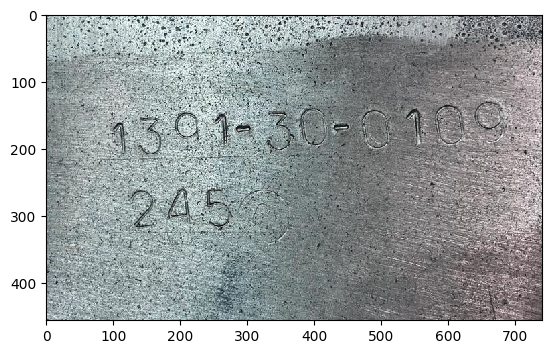

[2024/11/10 11:19:27] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.07045388221740723
[2024/11/10 11:19:27] ppocr DEBUG: cls num  : 2, elapsed : 0.004819154739379883
[2024/11/10 11:19:28] ppocr DEBUG: rec_res num  : 2, elapsed : 0.05431628227233887
RESULT [[[[[93.0, 140.0], [687.0, 119.0], [690.0, 196.0], [95.0, 217.0]], ('1391-30-0100', 0.9669899940490723)], [[[116.0, 251.0], [286.0, 248.0], [287.0, 323.0], [118.0, 326.0]], ('245', 0.9874626994132996)]]]
[     91.345      91.345      91.345      91.345      91.345      152.81      183.51      183.51      183.51      204.21]
240
РАСПОЗНАННЫЙ ТЕКСТ: 1391-30-0100 245
МАРКИРОВКА: "1391-30-0109 245"
0.41179847717285156

IMAGE SIZE; (1280, 960)

0: 480x640 1 marking, 6.3ms
Speed: 0.9ms preprocess, 6.3ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.52191     0.46243     0.22799     0.41889]]
COORD 522 814 243 645
CROP (402, 292, 3)


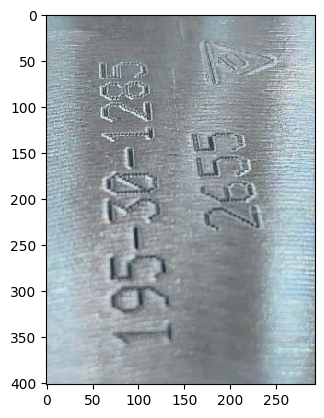

[2024/11/10 11:19:28] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.03694605827331543
[2024/11/10 11:19:28] ppocr DEBUG: cls num  : 2, elapsed : 0.0050585269927978516
[2024/11/10 11:19:28] ppocr DEBUG: rec_res num  : 2, elapsed : 0.05060291290283203
RESULT [[[[[40.0, 45.0], [123.0, 40.0], [146.0, 365.0], [62.0, 370.0]], ('195-30-1285', 0.9861024618148804)], [[[142.0, 110.0], [228.0, 101.0], [245.0, 242.0], [159.0, 252.0]], ('2655', 0.9949839115142822)]]]
[          0           0      18.228      26.004      28.842      28.842      28.842      29.844      29.844      32.445]
90
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1285 2655
МАРКИРОВКА: "195-30-1285 2655"
0.30809521675109863

IMAGE SIZE; (1280, 960)

0: 480x640 1 marking, 5.8ms
Speed: 0.9ms preprocess, 5.8ms inference, 0.5ms postprocess per image at shape (1, 3, 480, 640)
BBOX WH [[    0.45298     0.35415     0.43438     0.32677]]
COORD 302 858 183 497
CROP (314, 556, 3)


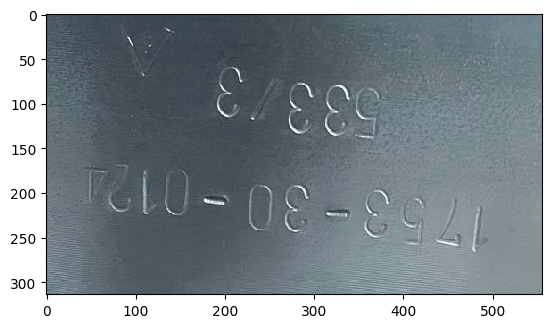

[2024/11/10 11:19:28] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.04952096939086914
[2024/11/10 11:19:28] ppocr DEBUG: cls num  : 2, elapsed : 0.004723548889160156
[2024/11/10 11:19:28] ppocr DEBUG: rec_res num  : 2, elapsed : 0.05522894859313965
RESULT [[[[[191.0, 51.0], [384.0, 78.0], [373.0, 150.0], [180.0, 123.0]], ('533/3', 0.9977375268936157)], [[[52.0, 164.0], [496.0, 209.0], [490.0, 266.0], [46.0, 221.0]], ('1753-30-0124', 0.9876048564910889)]]]
[     60.463      60.463      189.63      189.63      210.18      210.18      210.18      210.18      210.18      210.18]
169
РАСПОЗНАННЫЙ ТЕКСТ: 533/3 1753-30-0124
МАРКИРОВКА: "1753-30-0124"
0.32776832580566406

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.5ms
Speed: 0.9ms preprocess, 6.5ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.44576      0.2956     0.57571     0.14898]]
COORD 152 704 283 474
CROP (191, 552, 3)


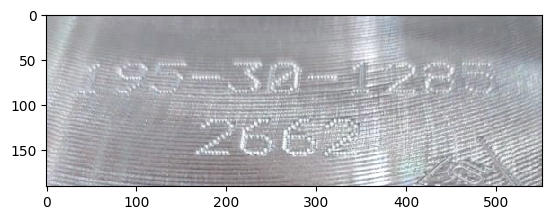

[2024/11/10 11:19:28] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.041100502014160156
[2024/11/10 11:19:28] ppocr DEBUG: cls num  : 2, elapsed : 0.004743337631225586
[2024/11/10 11:19:28] ppocr DEBUG: rec_res num  : 2, elapsed : 0.08478283882141113
RESULT [None]

IMAGE SIZE; (960, 1280)

0: 640x480 2 markings, 6.3ms
Speed: 1.0ms preprocess, 6.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.46041     0.49952     0.71349     0.25143]
 [    0.65453     0.90211     0.68408     0.19579]]
COORD 100 784 478 800
CROP (322, 684, 3)


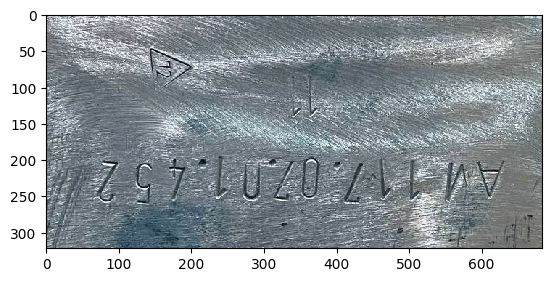

[2024/11/10 11:19:29] ppocr DEBUG: dt_boxes num : 1, elapsed : 0.056443214416503906
[2024/11/10 11:19:29] ppocr DEBUG: cls num  : 1, elapsed : 0.009207487106323242
[2024/11/10 11:19:29] ppocr DEBUG: rec_res num  : 1, elapsed : 0.04043388366699219
RESULT [[[[[68.0, 198.0], [629.0, 192.0], [629.0, 253.0], [69.0, 260.0]], ('AM-117.07.01.452', 0.9008975028991699)]]]
[     235.84      239.51      239.51      239.51      256.51      276.64      276.64      276.64      277.16      277.16]
20
РАСПОЗНАННЫЙ ТЕКСТ: AM-117.07.01.452
МАРКИРОВКА: "АМ117.07.01.452 10"
0.344468355178833

IMAGE SIZE; (960, 1280)

0: 640x480 1 marking, 6.3ms
Speed: 0.8ms preprocess, 6.3ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 480)
BBOX WH [[    0.46079       0.509     0.62055     0.21279]]
COORD 144 740 515 788
CROP (273, 596, 3)


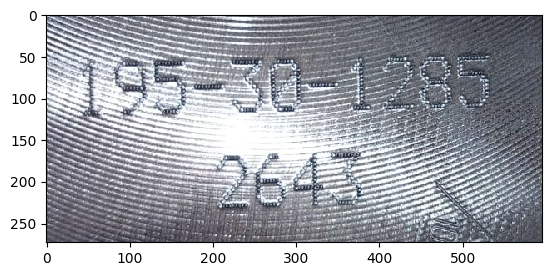

[2024/11/10 11:19:29] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.05024576187133789
[2024/11/10 11:19:29] ppocr DEBUG: cls num  : 2, elapsed : 0.0046234130859375
[2024/11/10 11:19:29] ppocr DEBUG: rec_res num  : 2, elapsed : 0.05190396308898926
RESULT [[[[[43.0, 52.0], [532.0, 45.0], [533.0, 112.0], [44.0, 120.0]], ('195-30-1285', 0.876223623752594)], [[[199.0, 164.0], [384.0, 157.0], [387.0, 230.0], [202.0, 237.0]], ('2643', 0.8781739473342896)]]]
[          0      38.866      38.866      38.866      40.301      40.301      44.218      44.218      44.218      44.733]
66
РАСПОЗНАННЫЙ ТЕКСТ: 195-30-1285 2643
МАРКИРОВКА: "195-30-1285 2643"
0.3277623653411865



In [39]:
result_list = predict_images(model_yolo, ocr, config['test_tmages_dir'])

In [40]:
for r in result_list:
    print(r)

['new80.JPG', '0 0.4988982379436493 0.2589506208896637 0.7196270823478699 0.1986062228679657', '"195-30-1285 2660"']
['new142.JPG', '0 0.5579833388328552 0.5232970714569092 0.2989967465400696 0.591855525970459', '"195-30-1285 2651"']
['new113.JPG', '0 0.5106111764907837 0.44003793597221375 0.36262717843055725 0.21336880326271057', '']
['new143.JPG', '0 0.42545491456985474 0.4572299122810364 0.34314367175102234 0.6545203924179077', '"195-30-1285 2653"']
['new140.JPG', '0 0.47123345732688904 0.38723644614219666 0.6324847340583801 0.24010086059570312', '"195-30-1285 2650"']
['new121.JPG', '0 0.5334562659263611 0.48704248666763306 0.6823892593383789 0.22378043830394745', '"195-30-1285 2639"']
['new90.JPG', '0 0.4755956530570984 0.45307785272598267 0.503646969795227 0.35087519884109497', '"195-30-1286 3093"']
['new100.JPG', '0 0.4690309166908264 0.43321654200553894 0.32141241431236267 0.22080813348293304', '']
['new138.JPG', '0 0.4252098798751831 0.2648596465587616 0.6605353355407715 0.1914

# Формируем файл

In [41]:
df = pd.DataFrame(result_list, columns=['image_file', 'label', 'label_text'])
df

,image_file,label,label_text
0,new80.JPG,0 0.4988982379436493 0.2589506208896637 0.7196...,"""195-30-1285 2660"""
1,new142.JPG,0 0.5579833388328552 0.5232970714569092 0.2989...,"""195-30-1285 2651"""
2,new113.JPG,0 0.5106111764907837 0.44003793597221375 0.362...,
3,new143.JPG,0 0.42545491456985474 0.4572299122810364 0.343...,"""195-30-1285 2653"""
4,new140.JPG,0 0.47123345732688904 0.38723644614219666 0.63...,"""195-30-1285 2650"""
...,...,...,...
108,new146.JPG,0 0.5219111442565918 0.4624277949333191 0.2279...,"""195-30-1285 2655"""
109,new31.JPG,0 0.45298123359680176 0.35414889454841614 0.43...,"""1753-30-0124"""
110,new109.JPG,0 0.44575807452201843 0.2955964207649231 0.575...,
111,new79.JPG,0 0.4604107141494751 0.4995240271091461 0.7134...,"""АМ117.07.01.452 10"""


In [42]:
df.to_csv('submission.csv', index=False)